select subject session FOV

In [13]:
#%% suggest neurons for next session based on previous sessions
import os
import BCI_analysis
import numpy as np
from matplotlib.backends.backend_pdf import PdfPages
from scipy.io import savemat
from scipy.stats import zscore
import shutil
import matplotlib.pyplot as plt
sessionwise_base_dir = '/home/jupyter/bucket/Data/Calcium_imaging/sessionwise_tba'
s2p_base_dir = '/home/jupyter/bucket/Data/Calcium_imaging/suite2p/Bergamo-2P-Photostim'
raw_scanimage_dir = '/home/jupyter/bucket/Data/Calcium_imaging/raw/Bergamo-2P-Photostim'
bpod_path = '/home/jupyter/bucket/Data/Behavior/BCI_exported/Bergamo-2P-Photostim/'

#next_session_dir = '/home/jupyter/bucket/Data/Calcium_imaging/next_session'
subject = 'BCI_41'
fov = 'FOV_01'
subject = 'BCI_42'
fov = 'FOV_02'
subject = 'BCI_43'
fov = 'FOV_01'

next_session_dir = '/home/jupyter/bucket/Data/Calcium_imaging/next_session/{}-{}/'.format(subject, fov)
files = os.listdir(os.path.join(sessionwise_base_dir,subject))
data_dict = {}
sessions = []
for file in files:
    
    if fov in file:
        session = file[len(subject)+1:-1*(len(fov)+5)]
        sessions.append(session)
        data_dict[session] = BCI_analysis.io_python.read_sessionwise_npy(os.path.join(sessionwise_base_dir,subject,file))
        #data_dict[session]['photon_counts']=np.load(os.path.join(s2p_base_dir,subject,fov,session,'photon_counts.npy'),allow_pickle=True).tolist()
        #data_dict[session]['f0_scalar'] = np.mean(np.load(os.path.join(s2p_base_dir,subject,fov,session,'F0.npy')),1)
        data_dict[session]['signal_to_noise_trace'] = data_dict[session]['dff_sessionwise']*data_dict[session]['photon_counts']['dprime_1dFF'][:,np.newaxis]
        print(file)
stat = np.load(os.path.join(s2p_base_dir,subject,fov,'stat.npy'),allow_pickle=True).tolist()
stat_rest = np.load(os.path.join(s2p_base_dir,subject,fov,'stat_rest.npy'),allow_pickle=True).tolist()
        #%
        #%
sessions = np.sort(list(data_dict.keys()))
cn_list = []
for session in sessions:
    try:
        toadd = None
        i_ = 0
        while toadd is None:
            try:
                toadd = np.asarray(data_dict[session]['cn'])[i_]
            except:
                pass
            i_+=1
        #cn_list.append(np.unique(np.asarray(data_dict[session]['cn'])[np.asarray(data_dict[session]['cn'])!=None])) # assuming that the CN is not changing
        cn_list.append(toadd)
        print(toadd)
    except: 
        pass
    #%
#cn_list = np.unique(cn_list)
#%


BCI_43-031023-FOV_01.npy
BCI_43-031323-FOV_01.npy
BCI_43-031423-FOV_01.npy
BCI_43-031523-FOV_01.npy
[ 1  2 22 65 40]
[65, 2, 40, 4, 38]
[8, 151, 44, 24, 44, 14, 8, 94, 19, 7, 20, 10, 151, 14, 85, 10, 19, 24, 3, 94]
[15, 6, 23, 180]


/tmp/ipykernel_32174/3595250291.py:49: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  toadd = np.asarray(data_dict[session]['cn'])[i_]


In [14]:
# select session
session_i = -1
last_session = session = sessions[session_i]
previous_session_i = -2
previous_session = sessions[previous_session_i]

In [15]:
#%% calculate event rate and stuff like that

# TODO amplitude should be calculated for each transient separately, then averaged over transients
# this way the long tails of long trials won't interfere
from pathlib import Path



#% calculate event rate
min_event_step = 10 # @20Hz - length of event
minimum_d_prime = 5
time_to_average_after_trial_start = 8 #seconds
baseline_end_t = -.5 # seconds before GO cue

file_list_to_copy_over = ['Z-positions.pdf',
                          'session_meanimages.tiff',
                          'ROI_sizes.pdf',
                          'ROIs.pdf',
                          'stat.mat',
                          'XYZ_motion.pdf',
                          'session_refImages.tiff',
                          'ops.mat']
#%

pixel_num_list = []
for s in stat:
    pixel_num_list.append(np.sum(s['soma_crop']))# &(s['overlap']==False)))
    #break
pixel_num_list=np.asarray(pixel_num_list)
    #%
for last_session in sessions: 
    trialwise_matrix_name = 'dff_trialwise_closed_loop'#'dff_trialwise_all'
    trialwise_dff_until_reward = data_dict[last_session][trialwise_matrix_name].copy()
    if trialwise_dff_until_reward.shape[2]==0:
        trialwise_matrix_name = 'dff_trialwise_all'
        trialwise_dff_until_reward = data_dict[last_session][trialwise_matrix_name].copy()
    trialwise_reward_matrix = np.nan*trialwise_dff_until_reward
    step_back =np.argmax(data_dict[last_session]['time_since_trial_start']>0) -1
    trial_len = len(data_dict[last_session]['time_since_trial_start'])
    for trial_i, reward_time in enumerate(data_dict[last_session]['reward_times']):
        if len(reward_time)>0:
            reward_idx = np.argmax(data_dict[last_session]['time_since_trial_start']>reward_time[0])
            if reward_idx == 0:
                reward_idx = len(data_dict[last_session]['time_since_trial_start'])
            trialwise_dff_until_reward[reward_idx:,:,trial_i] = np.nan
            trialwise_reward_matrix[:step_back+trial_len-reward_idx,:,trial_i] = data_dict[last_session][trialwise_matrix_name][reward_idx-step_back:,:,trial_i]
    mean_reward_matrix = np.nanmean(trialwise_reward_matrix,2).T
    std_reward_matrix = np.nanstd(trialwise_reward_matrix,2).T
    mean_activity_matrix = np.nanmean(trialwise_dff_until_reward,2).T
    baseline_length = np.argmax(data_dict[last_session]['time_since_trial_start']>data_dict[last_session]['go_cue_times'][0][0])#
    baseline_end = np.argmax(data_dict[last_session]['time_since_trial_start']>data_dict[last_session]['go_cue_times'][0][0]+baseline_end_t)#
    amplitude_length = np.argmax(data_dict[last_session]['time_since_trial_start']>time_to_average_after_trial_start)
    mean_activity_matrix_normalized = mean_activity_matrix-np.nanmean(mean_activity_matrix[:,:baseline_end],1)[:,np.newaxis]#/np.nanmean(mean_activity_matrix[:,:baseline_length],1)[:,np.newaxis] # TODO division is not needed here once real df/f is exported..
    mean_activity_matrix_normalized[np.isnan(mean_activity_matrix_normalized)] = 0
    mean_activity_matrix_normalized[np.isinf(mean_activity_matrix_normalized)] = 0
    data_dict[last_session]['mean_activity_matrix'] = mean_activity_matrix
    data_dict[last_session]['mean_reward_matrix'] = mean_reward_matrix
    

    amplitude = np.nanmean(mean_activity_matrix_normalized[:,baseline_length:amplitude_length],1)
    amplitude[amplitude>1] = 1
    amplitude[amplitude<-1] = -1
    stdev = np.nanstd(mean_activity_matrix_normalized[:,baseline_length:amplitude_length],1)
    #%
    events = data_dict[last_session]['signal_to_noise_trace']>minimum_d_prime
    event_edges = np.diff(np.concatenate([np.zeros([events.shape[0],1]),events,np.zeros([events.shape[0],1])],1))
    events_clean = np.zeros(events.shape)
    event_num = []
    event_amplitude = []
    for i,line in enumerate(event_edges):
        starts = np.where(line==1)[0]
        ends = np.where(line==-1)[0]
        lengths = ends-starts
        amplitudes = []
        for idx in np.where(lengths>=min_event_step)[0]:
            events_clean[i,starts[idx]:ends[idx]]=np.ones(lengths[idx])*np.nanmean(data_dict[last_session]['dff_sessionwise'][i,starts[idx]:ends[idx]])#*data_dict[last_session]['photon_counts']['dprime_1dFF'][i]
            amplitudes.append(np.max(data_dict[last_session]['dff_sessionwise'][i,starts[idx]:ends[idx]]))
        event_amplitude.append(np.mean(amplitudes))
        event_num.append(len(np.where(lengths>=min_event_step)[0]))
    events_clean[np.isnan(events_clean)] = 0
    events_clean[np.isinf(events_clean)] = 0
    event_rate = np.asarray(event_num)/(events.shape[1]/20/60)
    amplitude_rate = np.sum(events_clean,1)/(events.shape[1]/20)
    amplitude_rate[amplitude_rate<.001] = .001 #avoid zeros
    event_rate[event_rate<.001] = .001 #avoid zeros
    data_dict[last_session]['event_rate'] = event_rate
    data_dict[last_session]['amplitude_rate'] = amplitude_rate
    data_dict[last_session]['events_clean'] = events_clean
    data_dict[last_session]['trial_averaged_amplitude'] = amplitude
    
    

/tmp/ipykernel_32174/83606253.py:47: RuntimeWarning: Mean of empty slice
  mean_reward_matrix = np.nanmean(trialwise_reward_matrix,2).T
/tmp/ipykernel_32174/83606253.py:49: RuntimeWarning: Mean of empty slice
  mean_activity_matrix = np.nanmean(trialwise_dff_until_reward,2).T


In [16]:
# session_bpod_file = '/home/jupyter/bucket/Data/Behavior/BCI_exported/Bergamo-2P-Photostim/BCI_42/030923-bpod_zaber.npy'
# session_ops_file = '/home/jupyter/bucket/Data/Calcium_imaging/suite2p/Bergamo-2P-Photostim/BCI_42/FOV_02/030923/ops.npy'
# fov_stats_file = '/home/jupyter/bucket/Data/Calcium_imaging/suite2p/Bergamo-2P-Photostim/BCI_42/FOV_02/stat.npy'

# # session_bpod_file = '/home/jupyter/bucket/Data/Behavior/BCI_exported/Bergamo-2P-Photostim/BCI_41/030823-bpod_zaber.npy'
# # session_ops_file = '/home/jupyter/bucket/Data/Calcium_imaging/suite2p/Bergamo-2P-Photostim/BCI_41/FOV_01/030823/ops.npy'
# # fov_stats_file = '/home/jupyter/bucket/Data/Calcium_imaging/suite2p/Bergamo-2P-Photostim/BCI_41/FOV_01/stat.npy'

# temp = BCI_analysis.pipeline_imaging.find_conditioned_neuron_idx(session_bpod_file,
#                                                                 session_ops_file,
#                                                                 fov_stats_file, 
#                                                                 plot = True,
#                                                                 return_distances = False,
#                                                                 calculate_cn_lickport_correlation = False)

/tmp/ipykernel_32174/2162228870.py:11: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  cns = np.asarray(cn_list)[cn_session_i]


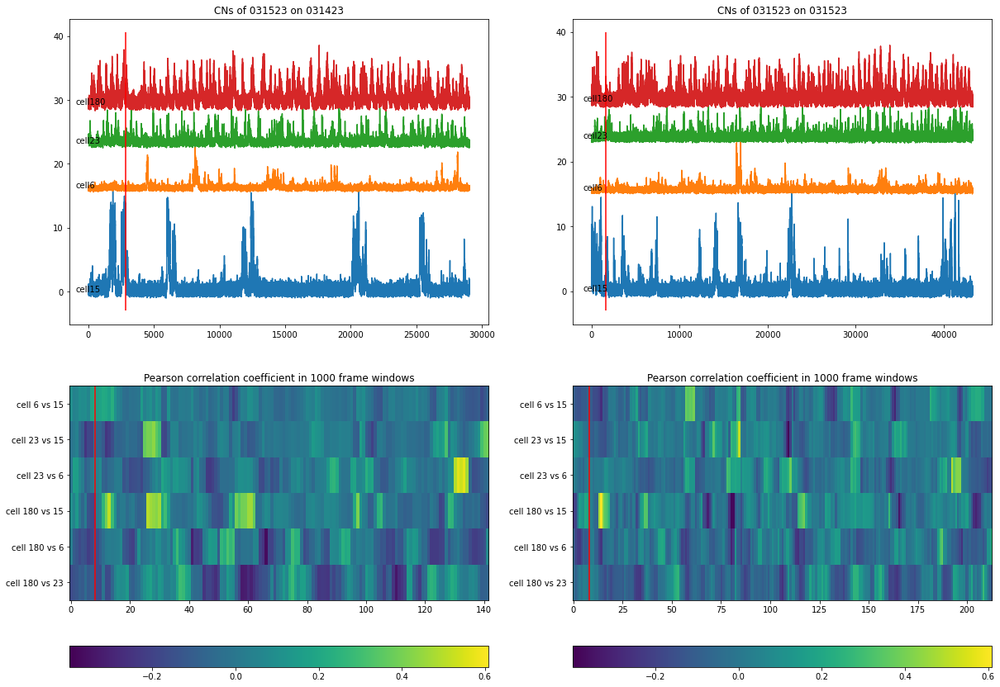

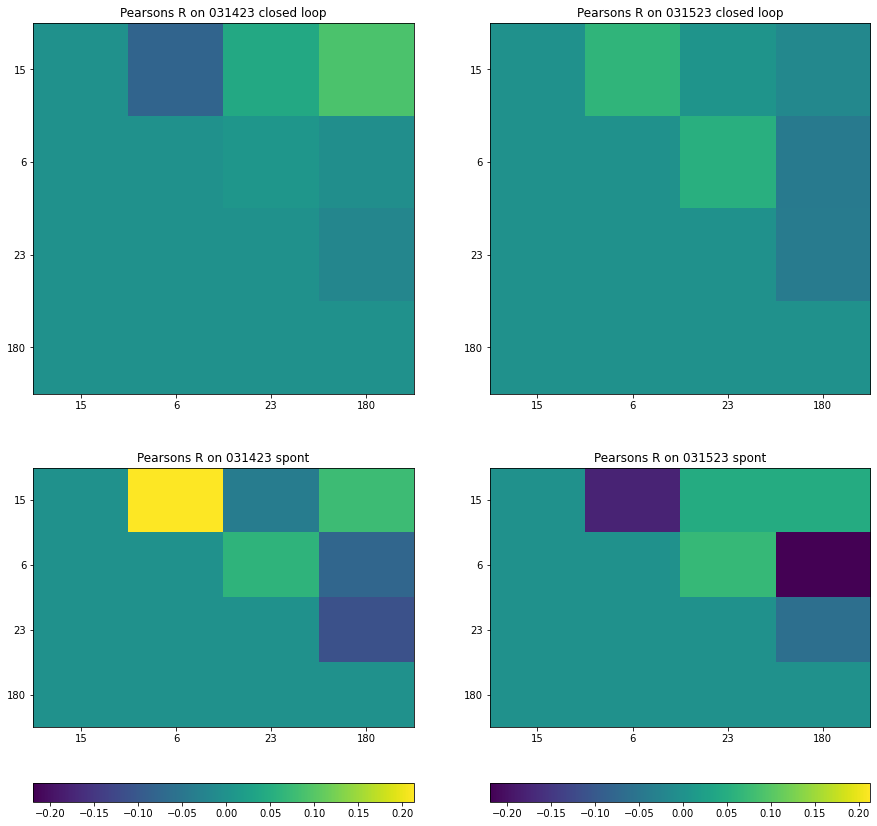

In [17]:
# look at correlations between CNs and compare to previous session

import scipy
#cns = cn_list
%matplotlib inline


trace_to_use = 'dff_sessionwise'#'F_sessionwise'#'dff_sessionwise'

cn_session_i = session_i#previous_session_i#
cns = np.asarray(cn_list)[cn_session_i]
if len(cns) == 1:
    cns = np.asarray(cn_list)[cn_session_i][0]
DFFs = data_dict[session][trace_to_use][cns,:]

fig = plt.figure(figsize = [20,15])
ax1 = fig.add_subplot(2,2,2)
ax1_prev = fig.add_subplot(2,2,1)
ax1.set_title('CNs of {} on {}'.format(sessions[cn_session_i],session))
ax1_prev.set_title('CNs of {} on {}'.format(sessions[cn_session_i],previous_session))
offset =  0
offset_prev = 0
corr_matrix = []
corr_matrix_prev = []
corr_matrix_labels = []
window_size =1000
window_step = 200

min_percentile = 50
exponent = 2

corr_matrix_dict = {'pearson_spont':np.zeros([len(cns),len(cns)]),
                    'pearson_closed_loop':np.zeros([len(cns),len(cns)]),
                    'pearson_spont_prev':np.zeros([len(cns),len(cns)]),
                    'pearson_closed_loop_prev':np.zeros([len(cns),len(cns)]),
                    'pearson_closed_loop_all_cells':[],
                    'pearson_closed_loop_prev_all_cells':[],
                    'pearson_all_cells_labels':[],
                   }
end_of_spont_idx = np.sum(np.asarray(data_dict[session]['all_si_frame_nums'])[:np.where(np.asarray(data_dict[session]['all_si_filenames']) == data_dict[session]['closed_loop_filenames'][0])[0][0]])
end_of_spont_idx_prev = np.sum(np.asarray(data_dict[previous_session]['all_si_frame_nums'])[:np.where(np.asarray(data_dict[previous_session]['all_si_filenames']) == data_dict[previous_session]['closed_loop_filenames'][0])[0][0]])
for cni,cn in enumerate(cns):
    dff = data_dict[session][trace_to_use][cn,:]
    ax1.plot(dff+offset)
    ax1.text(-1000,offset,'cell{}'.format(cn))
    offset += np.max(dff)
    
    dff_prev = data_dict[previous_session][trace_to_use][cn,:]
    ax1_prev.plot(dff_prev+offset_prev)
    ax1_prev.text(-1000,offset_prev,'cell{}'.format(cn))
    offset_prev += np.max(dff_prev)
    
    for cnii,cn2 in enumerate(cns[:cni]):
        dff2 = data_dict[session][trace_to_use][cn2,:]
        dff2_prev = data_dict[previous_session][trace_to_use][cn2,:]
        
        
        dff_rescaled = dff.copy()
        dff_rescaled = dff_rescaled-np.percentile(dff_rescaled,min_percentile)
        dff_rescaled = dff_rescaled/np.max(dff_rescaled)#*100
        dff_rescaled[dff_rescaled<0] = 0 
        dff_rescaled2 = dff2.copy()
        dff_rescaled2 = dff_rescaled2-np.percentile(dff_rescaled2,min_percentile)
        dff_rescaled2 = dff_rescaled2/np.max(dff_rescaled2)#*100
        dff_rescaled2[dff_rescaled2<0] = 0 

#         #rrsons_R, pearsons_p = scipy.stats.pearsonr(dff, dff2)
#         pearsons_R, pearsons_p = scipy.stats.pearsonr(dff_rescaled, dff_rescaled2)

#         synchrony = np.mean(((dff_rescaled+dff_rescaled2)/2)**exponent)
#         if use_synchrony:
#             corr_matrix[cni,cnii] = synchrony#pearsons_R
#         else:
#             corr_matrix[cni,cnii] = pearsons_R
#         synchrony_matrix[cni,cnii] = synchrony
        pearsons_R_spont, pearsons_p = scipy.stats.pearsonr(dff[:end_of_spont_idx], dff2[:end_of_spont_idx])
        corr_matrix_dict['pearson_spont'][cnii,cni] = pearsons_R_spont  #=corr_matrix_dict['pearson_spont'][cnii,cni] = 
        pearsons_R_closed_loop, pearsons_p = scipy.stats.pearsonr(dff[end_of_spont_idx:], dff2[end_of_spont_idx:])
        corr_matrix_dict['pearson_closed_loop'][cnii,cni]  = pearsons_R_closed_loop#=corr_matrix_dict['pearson_closed_loop'][cnii,cni]
        
        pearsons_R_spont, pearsons_p = scipy.stats.pearsonr(dff_prev[:end_of_spont_idx_prev], dff2_prev[:end_of_spont_idx_prev])
        corr_matrix_dict['pearson_spont_prev'][cnii,cni]  = pearsons_R_spont #=corr_matrix_dict['pearson_spont_prev'][cnii,cni]
        pearsons_R_closed_loop, pearsons_p = scipy.stats.pearsonr(dff_prev[end_of_spont_idx_prev:], dff2_prev[end_of_spont_idx_prev:])
        corr_matrix_dict['pearson_closed_loop_prev'][cnii,cni]  = pearsons_R_closed_loop#=corr_matrix_dict['pearson_closed_loop_prev'][cnii,cni]
        corr_list = []
        
        for wstart in np.arange(0,len(dff)-window_size+window_step,window_step):
            wend = wstart + window_size
            pearsons_R, pearsons_p = scipy.stats.pearsonr(dff[wstart:wend], dff2[wstart:wend])
            corr_list.append(pearsons_R)
        corr_matrix.append(np.asarray(corr_list))
        corr_matrix_labels.append('cell {} vs {}'.format(cn,cn2))
        
        corr_list_prev = []
        for wstart in np.arange(0,len(dff_prev)-window_size+window_step,window_step):
            wend = wstart + window_size
            pearsons_R, pearsons_p = scipy.stats.pearsonr(dff_prev[wstart:wend], dff2_prev[wstart:wend])
            corr_list_prev.append(pearsons_R)
        corr_matrix_prev.append(np.asarray(corr_list_prev))
            


ax1.vlines(end_of_spont_idx,ax1.get_ylim()[0],ax1.get_ylim()[1],color = 'red')   
ax1_prev.vlines(end_of_spont_idx_prev,ax1_prev.get_ylim()[0],ax1_prev.get_ylim()[1],color = 'red')   
corr_matrix = np.asarray(corr_matrix)
#corr_matrix_norm = corr_matrix-np.nanmean(corr_matrix[:,:3],1)[:,np.newaxis]

corr_matrix_prev = np.asarray(corr_matrix_prev)



ax2 = fig.add_subplot(2,2,4)
im = ax2.imshow(corr_matrix,aspect = 'auto',interpolation='none')
fig.colorbar(im, ax=ax2,location = 'bottom')
ax2.set_yticks(np.arange(len(corr_matrix_labels)))
ax2.set_yticklabels(corr_matrix_labels)
ax2.set_title('Pearson correlation coefficient in {} frame windows'.format(window_size))
ax2.vlines(end_of_spont_idx/window_step,ax2.get_ylim()[0],ax2.get_ylim()[1],color = 'red')   

ax2_prev = fig.add_subplot(2,2,3)
im_prev = ax2_prev.imshow(corr_matrix_prev,aspect = 'auto',interpolation='none')
fig.colorbar(im, ax=ax2_prev,location = 'bottom')
ax2_prev.set_yticks(np.arange(len(corr_matrix_labels)))
ax2_prev.set_yticklabels(corr_matrix_labels)
ax2_prev.set_title('Pearson correlation coefficient in {} frame windows'.format(window_size))
ax2_prev.vlines(end_of_spont_idx/window_step,ax2_prev.get_ylim()[0],ax2_prev.get_ylim()[1],color = 'red')   


im.set_clim([np.min([im_prev.get_clim()[0],im.get_clim()[0]]),np.max([im_prev.get_clim()[1],im.get_clim()[1]])])
im_prev.set_clim([np.min([im_prev.get_clim()[0],im.get_clim()[0]]),np.max([im_prev.get_clim()[1],im.get_clim()[1]])])

fig_crosscorrs = plt.figure(figsize = [15,15])


ax1_prev_day = fig_crosscorrs.add_subplot(2,2,1)
im1_prev = ax1_prev_day.imshow(corr_matrix_dict['pearson_closed_loop_prev'],aspect = 'auto')
ax1_prev_day.set_xticks(np.arange(len(cns)))
ax1_prev_day.set_xticklabels(cns)
ax1_prev_day.set_yticks(np.arange(len(cns)))
ax1_prev_day.set_yticklabels(cns)
ax1_prev_day.set_title('Pearsons R on {} closed loop'.format(previous_session))


ax1_test_day = fig_crosscorrs.add_subplot(2,2,2)
im1 = ax1_test_day.imshow(corr_matrix_dict['pearson_closed_loop'],aspect = 'auto')
ax1_test_day.set_xticks(np.arange(len(cns)))
ax1_test_day.set_xticklabels(cns)
ax1_test_day.set_yticks(np.arange(len(cns)))
ax1_test_day.set_yticklabels(cns)
ax1_test_day.set_title('Pearsons R on {} closed loop'.format(session))

ax1_prev_day_spont = fig_crosscorrs.add_subplot(2,2,3)
im1_prev_spont = ax1_prev_day_spont.imshow(corr_matrix_dict['pearson_spont_prev'],aspect = 'auto')
ax1_prev_day_spont.set_xticks(np.arange(len(cns)))
ax1_prev_day_spont.set_xticklabels(cns)
ax1_prev_day_spont.set_yticks(np.arange(len(cns)))
ax1_prev_day_spont.set_yticklabels(cns)
ax1_prev_day_spont.set_title('Pearsons R on {} spont'.format(previous_session))


ax1_test_day_spont = fig_crosscorrs.add_subplot(2,2,4)
im1_spont = ax1_test_day_spont.imshow(corr_matrix_dict['pearson_spont'],aspect = 'auto')
ax1_test_day_spont.set_xticks(np.arange(len(cns)))
ax1_test_day_spont.set_xticklabels(cns)
ax1_test_day_spont.set_yticks(np.arange(len(cns)))
ax1_test_day_spont.set_yticklabels(cns)
ax1_test_day_spont.set_title('Pearsons R on {} spont'.format(session))



im1_prev.set_clim([np.min([im1_prev.get_clim()[0],im1.get_clim()[0],im1_prev_spont.get_clim()[0],im1_spont.get_clim()[0]]),np.max([im1_prev.get_clim()[1],im1.get_clim()[1],im1_prev_spont.get_clim()[1],im1_spont.get_clim()[1]])])
im1.set_clim([np.min([im1_prev.get_clim()[0],im1.get_clim()[0],im1_prev_spont.get_clim()[0],im1_spont.get_clim()[0]]),np.max([im1_prev.get_clim()[1],im1.get_clim()[1],im1_prev_spont.get_clim()[1],im1_spont.get_clim()[1]])])
im1_prev_spont.set_clim([np.min([im1_prev.get_clim()[0],im1.get_clim()[0],im1_prev_spont.get_clim()[0],im1_spont.get_clim()[0]]),np.max([im1_prev.get_clim()[1],im1.get_clim()[1],im1_prev_spont.get_clim()[1],im1_spont.get_clim()[1]])])
im1_spont.set_clim([np.min([im1_prev.get_clim()[0],im1.get_clim()[0],im1_prev_spont.get_clim()[0],im1_spont.get_clim()[0]]),np.max([im1_prev.get_clim()[1],im1.get_clim()[1],im1_prev_spont.get_clim()[1],im1_spont.get_clim()[1]])])
fig_crosscorrs.colorbar(im1_spont, ax=ax1_test_day_spont,location = 'bottom')
fig_crosscorrs.colorbar(im1_spont, ax=ax1_prev_day_spont,location = 'bottom')

# calculate cc for all cells
cells_to_consider = 50
#cellnums = np.arange(data_dict[session][trace_to_use].shape[0]) 
event_rate_copy = data_dict[session]['event_rate'].copy()
cellnums = np.argsort(event_rate_copy)[::-1][:cells_to_consider]
for cni,cn in enumerate(cellnums):
    #print(cn)
    dff = data_dict[session][trace_to_use][cn,:]
    dff_prev = data_dict[previous_session][trace_to_use][cn,:]
    for cnii,cn2 in enumerate(cellnums[:cni]):
        dff2 = data_dict[session][trace_to_use][cn2,:]
        dff2_prev = data_dict[previous_session][trace_to_use][cn2,:]
        pearsons_R_closed_loop, pearsons_p = scipy.stats.pearsonr(dff[end_of_spont_idx:], dff2[end_of_spont_idx:])
        corr_matrix_dict['pearson_closed_loop_all_cells'].append(pearsons_R_closed_loop)
        corr_matrix_dict['pearson_all_cells_labels'].append([cn,cn2])
        pearsons_R_closed_loop_prev, pearsons_p = scipy.stats.pearsonr(dff_prev[end_of_spont_idx_prev:], dff2_prev[end_of_spont_idx_prev:])
        corr_matrix_dict['pearson_closed_loop_prev_all_cells'].append(pearsons_R_closed_loop_prev)

        
        
        
        

#ax1.set_xlim([0,5000])

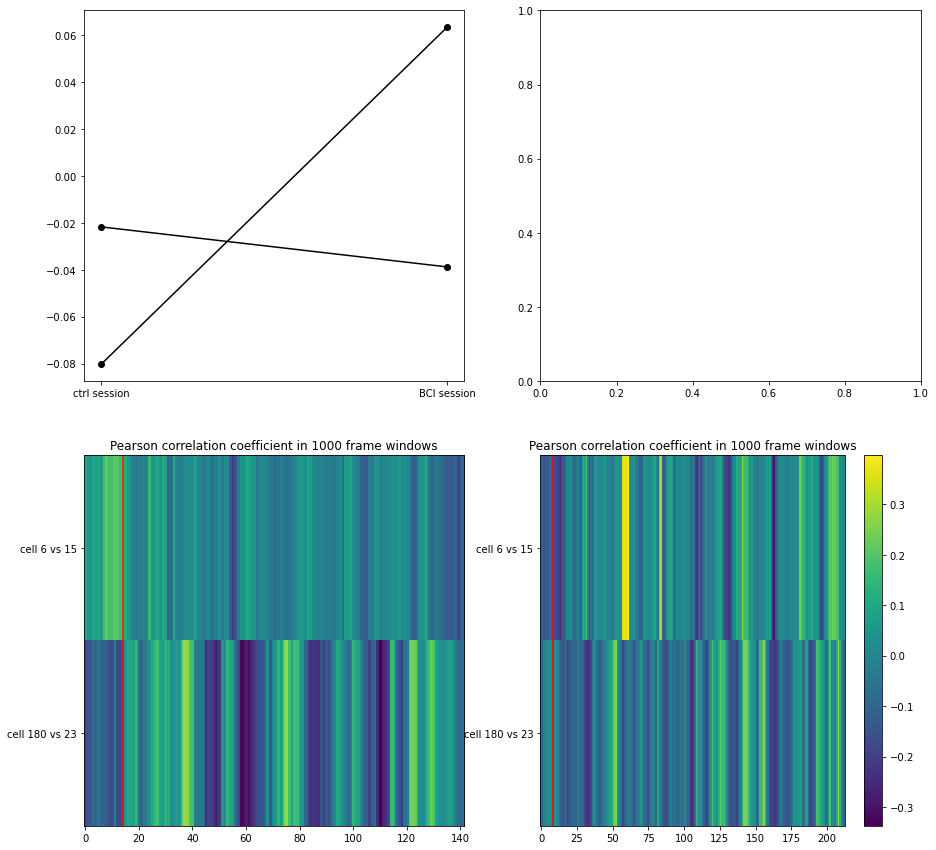

In [18]:
# multiple cell-pair paradigm (cells 1vs2, 3vs4, 5vs6 ....) out = a*b ------ non-correlating cells were selected

closed_loop_prev_list = []
closed_loop_list = []
corr_matrix_pairs = []
corr_matrix_prev_pairs = []
corr_matrix_labels_pairs = []

fig = plt.figure(figsize = [15,15])
ax = fig.add_subplot(2,2,1)
ax_cb = fig.add_subplot(2,2,2)
ax_corr_prev = fig.add_subplot(2,2,3)
ax_corr = fig.add_subplot(2,2,4)


for cni in np.arange(0,len(cns),2):
    cnii = cni + 1
    #corr_matrix_dict['pearson_closed_loop']
    closed_loop_prev_list.append(corr_matrix_dict['pearson_closed_loop_prev'][cni,cnii])
    closed_loop_list.append(corr_matrix_dict['pearson_closed_loop'][cni,cnii])
    ax.plot(['ctrl session','BCI session'],[corr_matrix_dict['pearson_closed_loop_prev'][cni,cnii],corr_matrix_dict['pearson_closed_loop'][cni,cnii]],'k-o')
    matrix_idx = np.where(np.asarray(corr_matrix_labels) == 'cell {} vs {}'.format(cns[cnii],cns[cni]))[0][0]
    
    corr_matrix_pairs.append(corr_matrix[matrix_idx,:])
    corr_matrix_prev_pairs.append(corr_matrix_prev[matrix_idx,:])
    corr_matrix_labels_pairs.append(corr_matrix_labels[matrix_idx])
im = ax_corr.imshow(np.asarray(corr_matrix_pairs),aspect = 'auto',interpolation='none')
im_prev = ax_corr_prev.imshow(np.asarray(corr_matrix_prev_pairs),aspect = 'auto',interpolation='none')

ax_corr.set_yticks(np.arange(len(corr_matrix_labels_pairs)))
ax_corr.set_yticklabels(corr_matrix_labels_pairs)
ax_corr.set_title('Pearson correlation coefficient in {} frame windows'.format(window_size))
ax_corr.vlines(end_of_spont_idx/window_step,ax_corr.get_ylim()[0],ax_corr.get_ylim()[1],color = 'red')   

ax_corr_prev.set_yticks(np.arange(len(corr_matrix_labels_pairs)))
ax_corr_prev.set_yticklabels(corr_matrix_labels_pairs)
ax_corr_prev.set_title('Pearson correlation coefficient in {} frame windows'.format(window_size))
ax_corr_prev.vlines(end_of_spont_idx_prev/window_step,ax_corr_prev.get_ylim()[0],ax_corr_prev.get_ylim()[1],color = 'red')   

im.set_clim([np.min([im_prev.get_clim()[0],im.get_clim()[0]]),np.max([im_prev.get_clim()[1],im.get_clim()[1]])])
im_prev.set_clim([np.min([im_prev.get_clim()[0],im.get_clim()[0]]),np.max([im_prev.get_clim()[1],im.get_clim()[1]])])

fig.colorbar(im, ax=ax_corr)#,location = 'center')


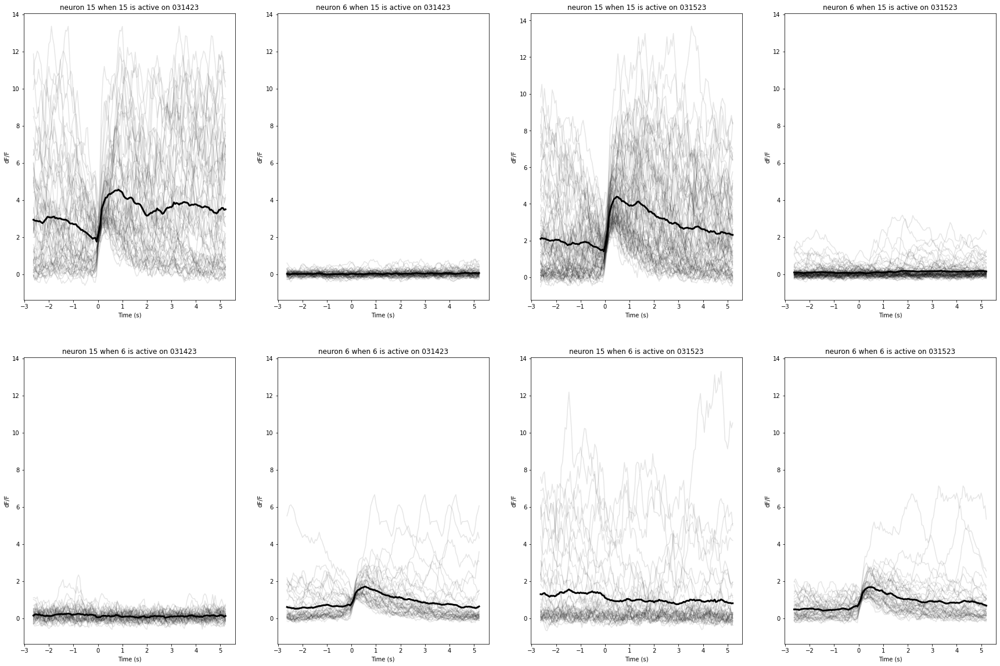

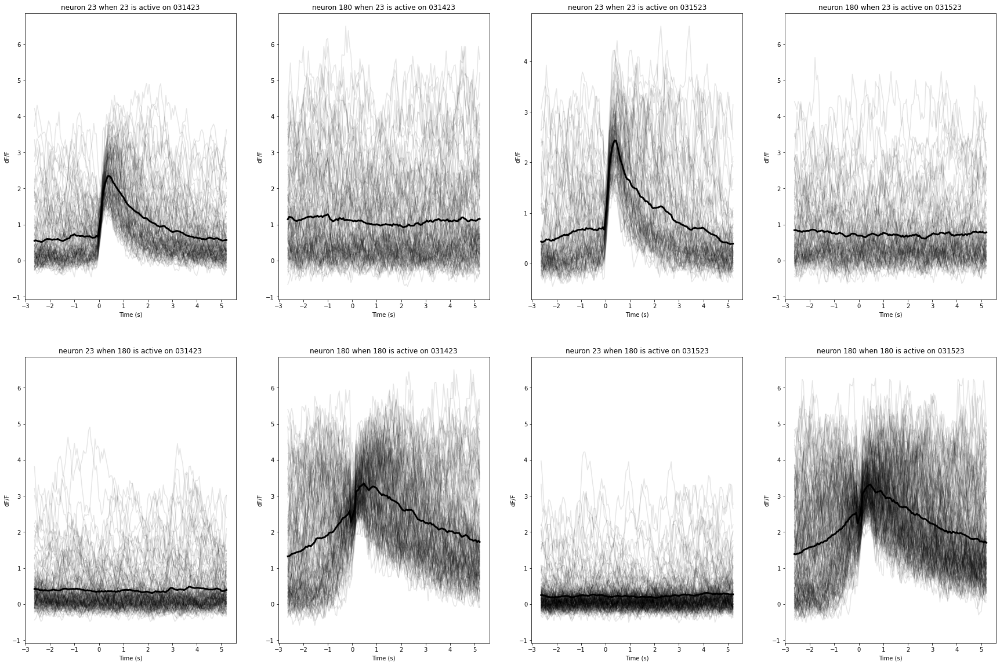

In [19]:
step_back =50
step_forward = 100
time_v = np.arange(-step_back,step_forward)/19
for cni in np.arange(0,len(cns),2):
    fig = plt.figure(figsize = [30,20])
    cnii = cni + 1
    cn = cns[cni]
    cn2 = cns[cnii]
    
    
    for session_i_now, session_now in enumerate([previous_session, session]):
        cn1event_locked_traces_cn1 = []
        cn1event_locked_traces_cn2 = []
        cn2event_locked_traces_cn1 = []
        cn2event_locked_traces_cn2 = []
        event_indices = np.where((np.diff(data_dict[session_now]['events_clean'])>0)[cn,:])[0]
        event_indices_cn2 = np.where((np.diff(data_dict[session_now]['events_clean'])>0)[cn2,:])[0]
        dff_cn = BCI_analysis.plot_utils.rollingfun(data_dict[session_now]['dff_sessionwise'][cn,:],4,'mean')
        dff_cn2 = BCI_analysis.plot_utils.rollingfun(data_dict[session_now]['dff_sessionwise'][cn2,:],4,'mean')
        for event_idx in event_indices:
            if event_idx>step_back+1 and event_idx<len(dff_cn)-step_forward-1:
                cn1event_locked_traces_cn1.append(dff_cn[event_idx-step_back:event_idx+step_forward])
                cn1event_locked_traces_cn2.append(dff_cn2[event_idx-step_back:event_idx+step_forward])

        for event_idx in event_indices_cn2:
            if event_idx>step_back+1 and event_idx<len(dff_cn)-step_forward-1:
                cn2event_locked_traces_cn1.append(dff_cn[event_idx-step_back:event_idx+step_forward])
                cn2event_locked_traces_cn2.append(dff_cn2[event_idx-step_back:event_idx+step_forward])
        if session_i_now>0:
            ax_1 = fig.add_subplot(2,4,1 + session_i_now*2,sharex = ax_0)
        else:
            ax_1 = fig.add_subplot(2,4,1 + session_i_now*2)
        ax_1.plot(time_v,np.asarray(cn1event_locked_traces_cn1).T,'k-',alpha = .1)
        ax_1.plot(time_v,np.nanmean(cn1event_locked_traces_cn1,0),'k-',alpha = 1,linewidth = 3)
        
        if session_i_now == 0:
            ax_0 = ax_1
        ax_2 = fig.add_subplot(2,4,2+ session_i_now*2,sharey = ax_0)
        ax_2.plot(time_v,np.asarray(cn1event_locked_traces_cn2).T,'k-',alpha = .1)
        ax_2.plot(time_v,np.nanmean(cn1event_locked_traces_cn2,0),'k-',alpha = 1,linewidth = 3)
        ax_1.set_title('neuron {} when {} is active on {}'.format(cn,cn,session_now))
        ax_2.set_title('neuron {} when {} is active on {}'.format(cn2,cn,session_now))
        ax_1.set_xlabel('Time (s)')
        ax_1.set_ylabel('dF/F')
        ax_2.set_xlabel('Time (s)')
        ax_2.set_ylabel('dF/F')
        ax_1 = fig.add_subplot(2,4,5 + session_i_now*2,sharey = ax_0)
        ax_1.plot(time_v,np.asarray(cn2event_locked_traces_cn1).T,'k-',alpha = .1)
        ax_1.plot(time_v,np.nanmean(cn2event_locked_traces_cn1,0),'k-',alpha = 1,linewidth = 3)
        ax_2 = fig.add_subplot(2,4,6 + session_i_now*2,sharey = ax_0)
        ax_2.plot(time_v,np.asarray(cn2event_locked_traces_cn2).T,'k-',alpha = .1)
        ax_2.plot(time_v,np.nanmean(cn2event_locked_traces_cn2,0),'k-',alpha = 1,linewidth = 3)
        ax_1.set_title('neuron {} when {} is active on {}'.format(cn,cn2,session_now))
        ax_2.set_title('neuron {} when {} is active on {}'.format(cn2,cn2,session_now))
        ax_1.set_xlabel('Time (s)')
        ax_1.set_ylabel('dF/F')
        ax_2.set_xlabel('Time (s)')
        ax_2.set_ylabel('dF/F')
    #asdsa

In [20]:
corr_matrix_dict.keys()

dict_keys(['pearson_spont', 'pearson_closed_loop', 'pearson_spont_prev', 'pearson_closed_loop_prev', 'pearson_closed_loop_all_cells', 'pearson_closed_loop_prev_all_cells', 'pearson_all_cells_labels'])

Text(0, 0.5, 'pairwise Pearson R conditioning day')

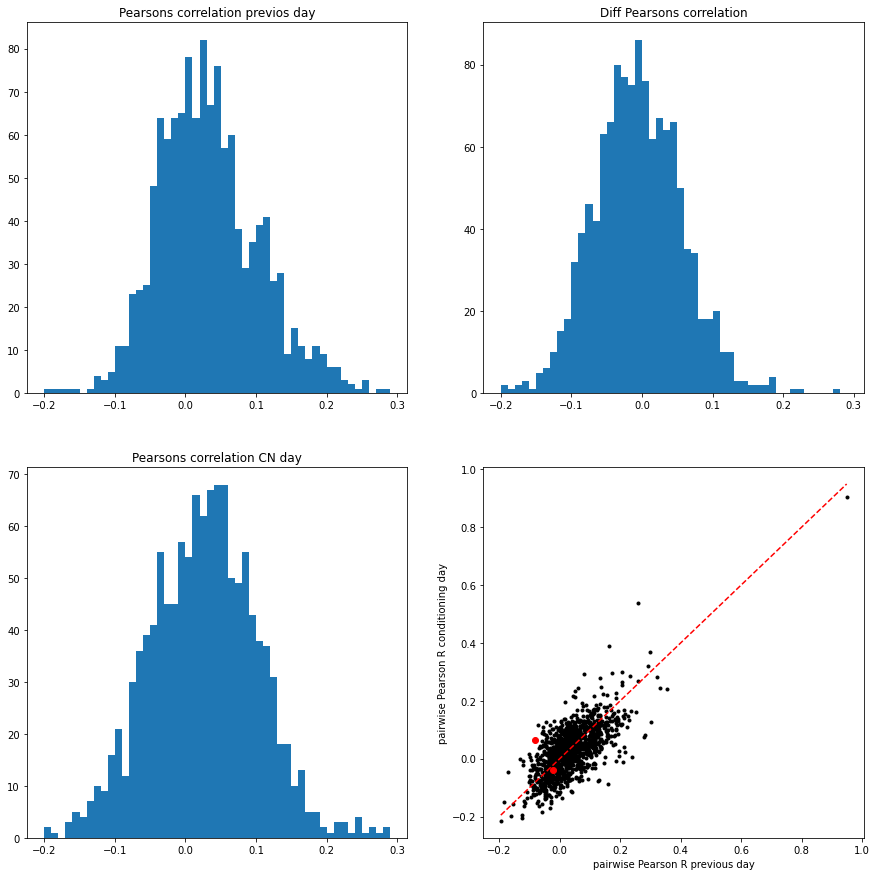

In [21]:
corr_diff = np.asarray(corr_matrix_dict['pearson_closed_loop_all_cells'])-np.asarray(corr_matrix_dict['pearson_closed_loop_prev_all_cells'])
cn_diff = corr_matrix_dict['pearson_closed_loop'] - corr_matrix_dict['pearson_closed_loop_prev']
cn_diff = cn_diff[cn_diff != 0]
cn_prev = np.asarray(corr_matrix_dict['pearson_closed_loop_prev'])
cn_prev = cn_prev[cn_prev != 0]
cn_now = np.asarray(corr_matrix_dict['pearson_closed_loop'])
cn_now = cn_now[cn_now != 0]
hist_range = np.arange(-.2,.3,.01)
fig = plt.figure(figsize = [15,15])
ax_hist_prev = fig.add_subplot(2,2,1)
ax_hist_now = fig.add_subplot(2,2,3)
ax_hist_diff = fig.add_subplot(2,2,2)
ax_scatter = fig.add_subplot(2,2,4)
ax_hist_prev.hist(corr_matrix_dict['pearson_closed_loop_prev_all_cells'],hist_range)
ax_hist_prev.set_title('Pearsons correlation previos day')
ax_hist_now.hist(corr_matrix_dict['pearson_closed_loop_all_cells'],hist_range)
ax_hist_now.set_title('Pearsons correlation CN day')

ax_hist_diff.hist(corr_diff,hist_range)
ax_hist_diff.set_title('Diff Pearsons correlation')
# ax_hist_now.plot(cn_now,np.ones(len(cn_diff))*100,'r.')
# ax_hist_prev.plot(cn_prev,np.ones(len(cn_diff))*100,'r.')
# ax_hist_diff.plot(cn_diff,np.ones(len(cn_diff))*100,'r.')
ax_scatter.plot(corr_matrix_dict['pearson_closed_loop_prev_all_cells'],corr_matrix_dict['pearson_closed_loop_all_cells'],'k.')

for cni in np.arange(0,len(cns),2):
    cnii = cni + 1
    #corr_matrix_dict['pearson_closed_loop']
    closed_loop_prev_list.append(corr_matrix_dict['pearson_closed_loop_prev'][cni,cnii])
    closed_loop_list.append(corr_matrix_dict['pearson_closed_loop'][cni,cnii])
    ax_scatter.plot(corr_matrix_dict['pearson_closed_loop_prev'][cni,cnii],corr_matrix_dict['pearson_closed_loop'][cni,cnii],'ro')
ax_scatter.plot([np.min(corr_matrix_dict['pearson_closed_loop_prev_all_cells']),np.max(corr_matrix_dict['pearson_closed_loop_prev_all_cells'])],[np.min(corr_matrix_dict['pearson_closed_loop_prev_all_cells']),np.max(corr_matrix_dict['pearson_closed_loop_prev_all_cells'])],'r--')
ax_scatter.set_xlabel('pairwise Pearson R previous day')
ax_scatter.set_ylabel('pairwise Pearson R conditioning day')

In [23]:
data_dict[session_now]['dff_sessionwise'].shape

(382, 43269)

In [52]:
# calculate the pearson R for all cells and the CNs on both days
cns_now = [15,6] # a cell-pair that is changing it's correlation
cell_num = data_dict[session_now]['dff_sessionwise'].shape[0]
cc_dict = {previous_session: np.zeros([len(cns_now),cell_num]),
           session: np.zeros([len(cns_now),cell_num])}
for session_i_now, (session_now,end_of_spont_idx_now) in enumerate(zip([previous_session, session],[end_of_spont_idx_prev,end_of_spont_idx])):
    for cn_i,cn in enumerate(cns_now):
        dff = data_dict[session_now]['dff_sessionwise'][cn,:]
        for other_cell in np.arange(cell_num):
            dff_cell = data_dict[session_now]['dff_sessionwise'][other_cell,:]
            cc_dict[session_now][cn_i,other_cell],  pearsons_p = scipy.stats.pearsonr(dff[end_of_spont_idx_now:], dff_cell[end_of_spont_idx_now:])




In [66]:
median_cc

nan

Text(0.5, 1.0, '031523 to 031423')

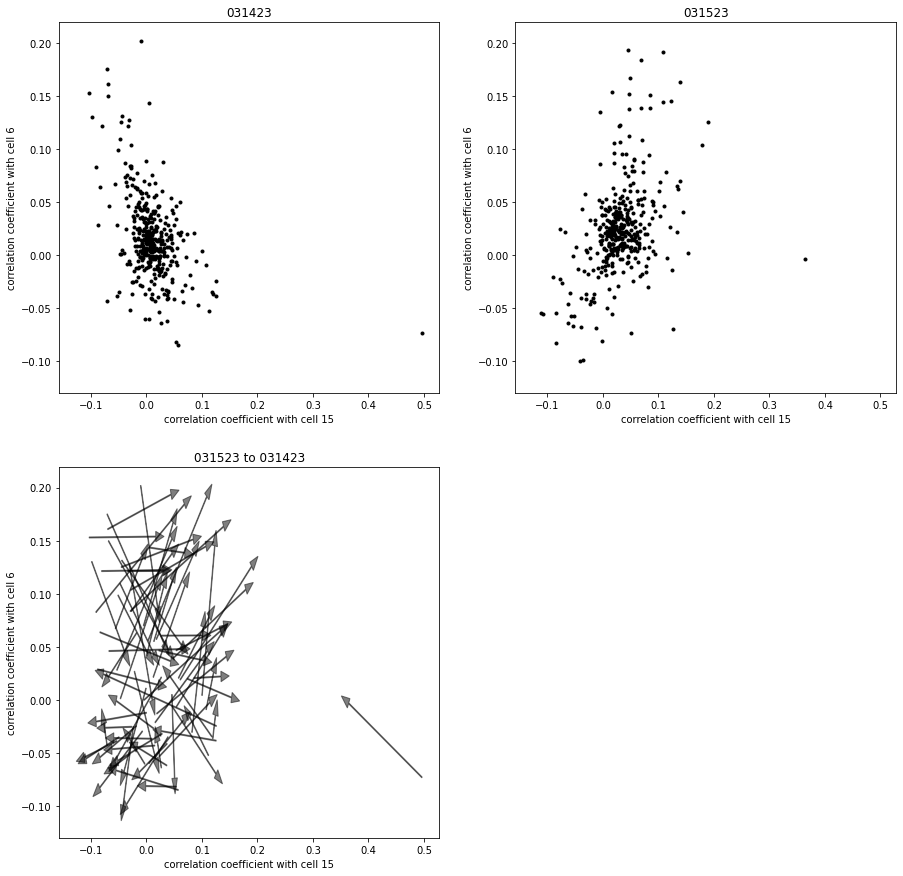

In [84]:
cc_dict[previous_session][cc_dict[previous_session]>.999] = np.nan
cc_dict[session][cc_dict[session]>.999] = np.nan

fig = plt.figure(figsize = [15,15])
ax1 = fig.add_subplot(2,2,2)
ax1.plot(cc_dict[session][0,:],cc_dict[session][1,:],'k.')
ax1.set_xlabel('correlation coefficient with cell {}'.format(cns_now[0]))
ax1.set_ylabel('correlation coefficient with cell {}'.format(cns_now[1]))
ax1.set_title(session)



ax2 = fig.add_subplot(2,2,1,sharex = ax1,sharey = ax1)
ax2.plot(cc_dict[previous_session][0,:],cc_dict[previous_session][1,:],'k.')
ax2.set_xlabel('correlation coefficient with cell {}'.format(cns_now[0]))
ax2.set_ylabel('correlation coefficient with cell {}'.format(cns_now[1]))
ax2.set_title(previous_session)

# ax2.set_xlim([-.2,.4])
# ax2.set_ylim([-.2,.4])

ax3 = fig.add_subplot(2,2,3,sharex = ax1,sharey = ax1)
median_cc = np.nanmedian(cc_dict[session].flatten())
for i in np.arange(cell_num):
    
    #ax3.plot(cc_dict[session][0,i],cc_dict[session][1,i],'k.',alpha = 1)
    if np.max(np.abs(np.asarray([cc_dict[session][0,i],cc_dict[previous_session][0,i],cc_dict[session][1,i],cc_dict[previous_session][1,i]])-median_cc))>.075:
        ax3.arrow(cc_dict[previous_session][0,i], 
                  cc_dict[previous_session][1,i], 
                  cc_dict[session][0,i]-cc_dict[previous_session][0,i],
                  cc_dict[session][1,i]-cc_dict[previous_session][1,i],
                 head_width = .01,
                 color = 'black',
                 alpha = .5)
        #ax3.plot([cc_dict[session][0,i],cc_dict[previous_session][0,i]],[cc_dict[session][1,i],cc_dict[previous_session][1,i]],'r-',alpha = .5)
ax3.set_xlabel('correlation coefficient with cell {}'.format(cns_now[0]))
ax3.set_ylabel('correlation coefficient with cell {}'.format(cns_now[1]))
ax3.set_title('{} to {}'.format(session,previous_session))


In [62]:
np.max([cc_dict[session][0,i],cc_dict[previous_session][0,i],cc_dict[session][1,i],cc_dict[previous_session][1,i]])

0.022002006524126146

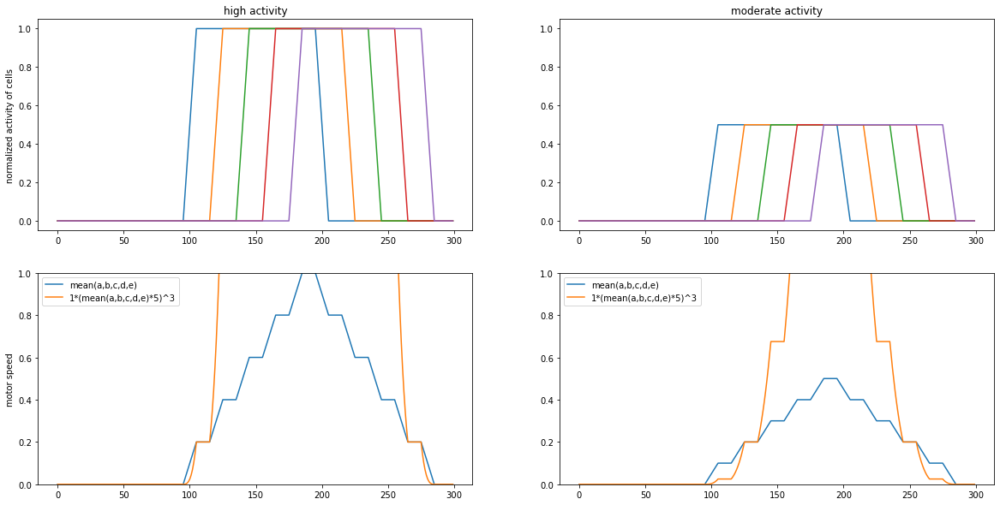

In [402]:
# TRY this recipe - 

base_value = 5
exponent =3
multiplier = 1


base_value = 5
exponent =3
multiplier = 1


activity = 1
activity2 = .5
rollval = 20
a = BCI_analysis.plot_utils.rollingfun(np.concatenate([np.zeros(100),np.ones(100),np.zeros(100)]),10,'mean')*base_value *activity
b = np.roll(a,rollval)
c = np.roll(b,rollval)
d = np.roll(c,rollval)
e = np.roll(d,rollval)

a2 = BCI_analysis.plot_utils.rollingfun(np.concatenate([np.zeros(100),np.ones(100),np.zeros(100)]),10,'mean')*base_value *activity2
b2 = np.roll(a2,rollval)
c2 = np.roll(b2,rollval)
d2 = np.roll(c2,rollval)
e2 = np.roll(d2,rollval)



fig = plt.figure(figsize = [20,10])
ax1 = fig.add_subplot(2,2,1)
ax2 = fig.add_subplot(2,2,3)
ax3 = fig.add_subplot(2,2,2,sharey = ax1)
ax4 = fig.add_subplot(2,2,4,sharey = ax2)
ax1.plot(a/base_value,label = a)
ax1.plot(b/base_value)
ax1.plot(c/base_value)
ax1.plot(d/base_value)
ax1.plot(e/base_value)
ax1.set_ylabel('normalized activity of cells')
ax1.set_title('high activity')
ax3.plot(a2/base_value,label = a)
ax3.plot(b2/base_value)
ax3.plot(c2/base_value)
ax3.plot(d2/base_value)
ax3.plot(e2/base_value)
ax3.set_title('moderate activity')

y = np.mean([a,b,c,d,e],0)/base_value
ax2.plot(y,label = 'mean(a,b,c,d,e)')
y2 = np.mean([a2,b2,c2,d2,e2],0)/base_value
ax4.plot(y2,label = 'mean(a,b,c,d,e)')

y = (multiplier*np.mean([a,b,c,d,e],0)**exponent)/base_value
ax2.plot(y,label = '{}*(mean(a,b,c,d,e)*{})^{}'.format(multiplier,base_value,exponent))
ax2.set_ylim([0,1])
ax2.legend()
ax2.set_ylabel('motor speed')

y2 = (multiplier*np.mean([a2,b2,c2,d2,e2],0)**exponent)/base_value
ax4.plot(y2,label = '{}*(mean(a,b,c,d,e)*{})^{}'.format(multiplier,base_value,exponent))
ax4.legend()

to do:
    - select 4 groups of 5 cells with low to high correlation, all should be high activity cells
    - save data and try experiment again

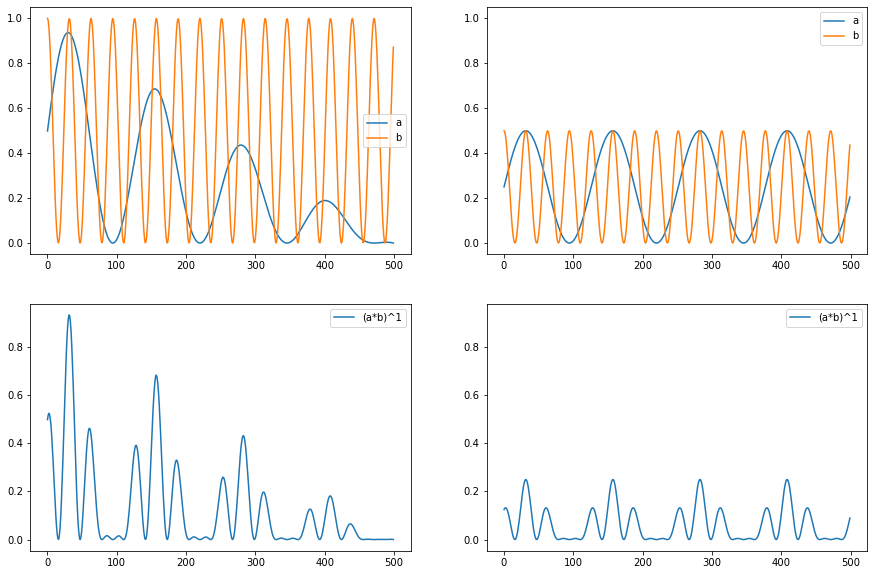

In [605]:
exponent = 1

fig = plt.figure(figsize = [15,10])
ax1_low = fig.add_subplot(2,2,2)
ax1_high = fig.add_subplot(2,2,1,sharey = ax1_low)
ax2_low = fig.add_subplot(2,2,4)
ax2_high = fig.add_subplot(2,2,3,sharey = ax2_low)
low_amplitude = .5
high_amplitude = 1
x = np.arange(0,50,.1)
a  = (0.5+np.sin(x/2)/2)*low_amplitude
b = (0.5+np.cos(x*2)/2)*low_amplitude
ax1_low.plot(a,label = 'a')
ax1_low.plot(b,label = 'b')
output = (a*b)**exponent
ax2_low.plot(output,label = '(a*b)^{}'.format(exponent))
ax1_low.legend()
ax2_low.legend()


a  = (0.5+np.sin(x/2)/2)*high_amplitude*np.arange(len(x))[::-1]/len(x)
b = (0.5+np.cos(x*2)/2)*high_amplitude
ax1_high.plot(a,label = 'a')
ax1_high.plot(b,label = 'b')
output = (a*b)**exponent
ax2_high.plot(output,label = '(a*b)^{}'.format(exponent))
ax1_high.legend()
ax2_high.legend()
#ax2_high.set_ylim([0,1])

In [38]:
 np.sum(np.concatenate(cells_included_so_far)==cell_now)

1

/tmp/ipykernel_5928/3386295418.py:121: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize = [15,20])


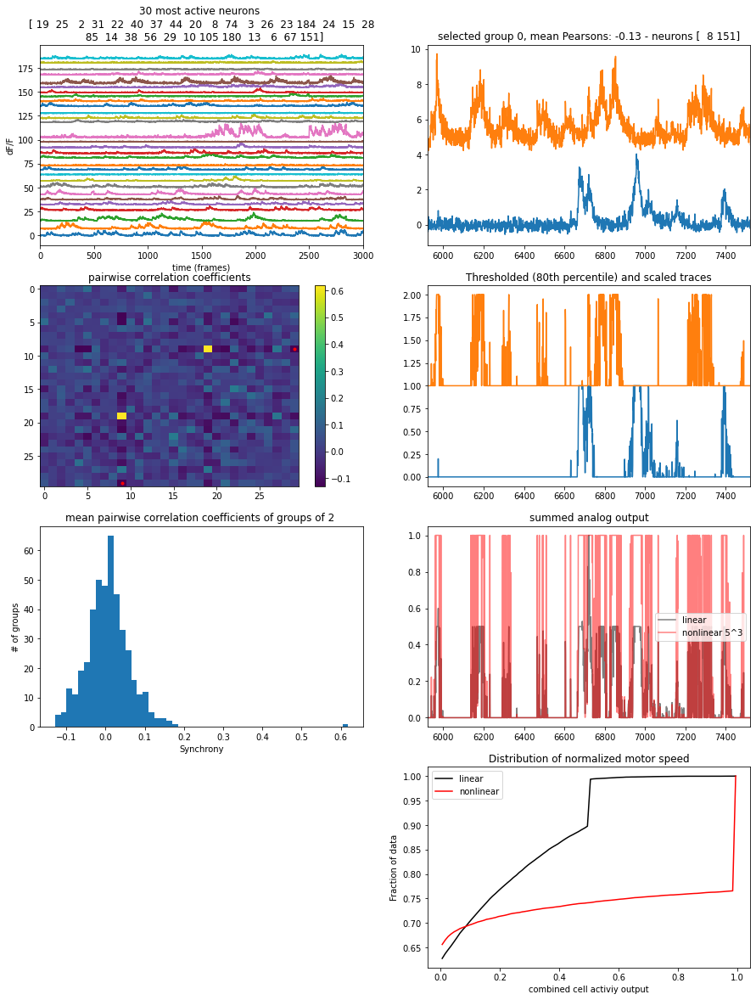

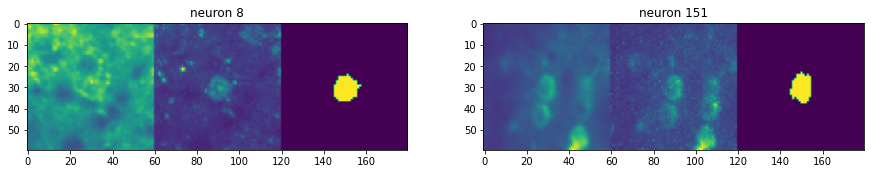

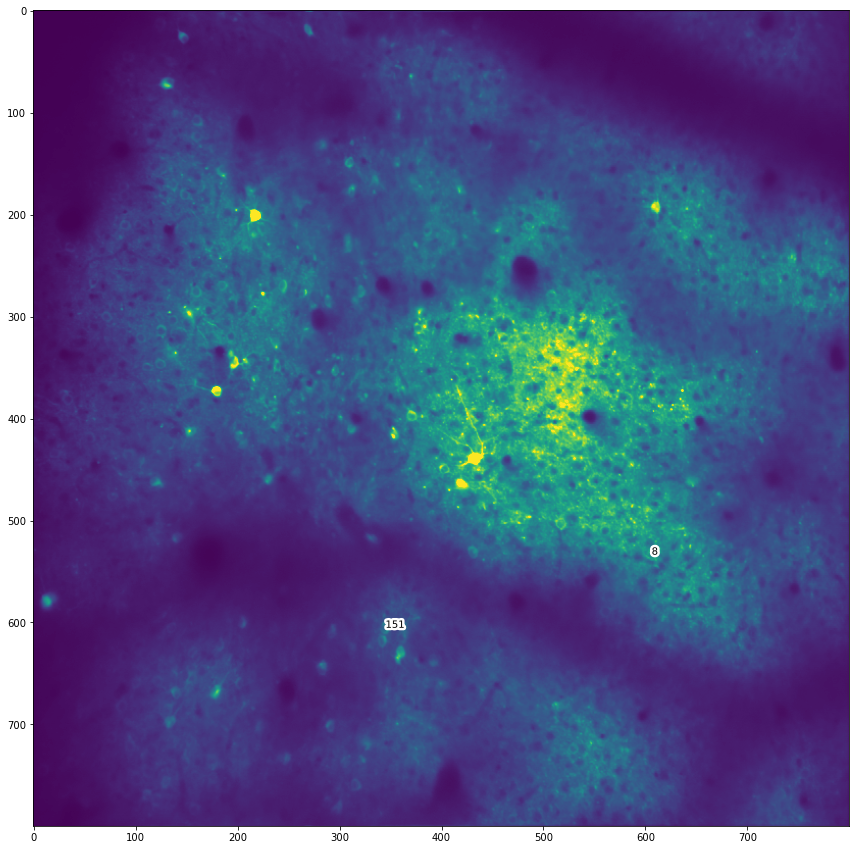

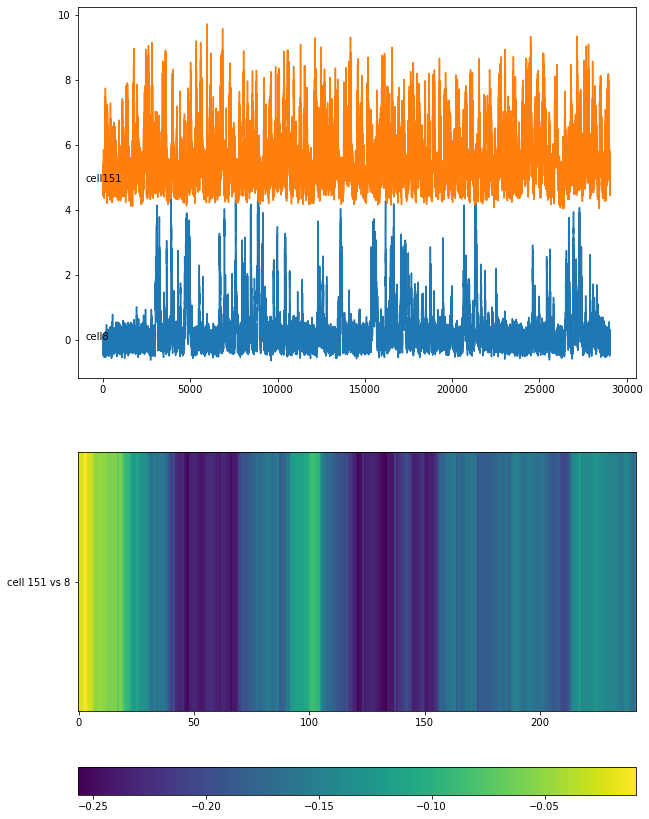

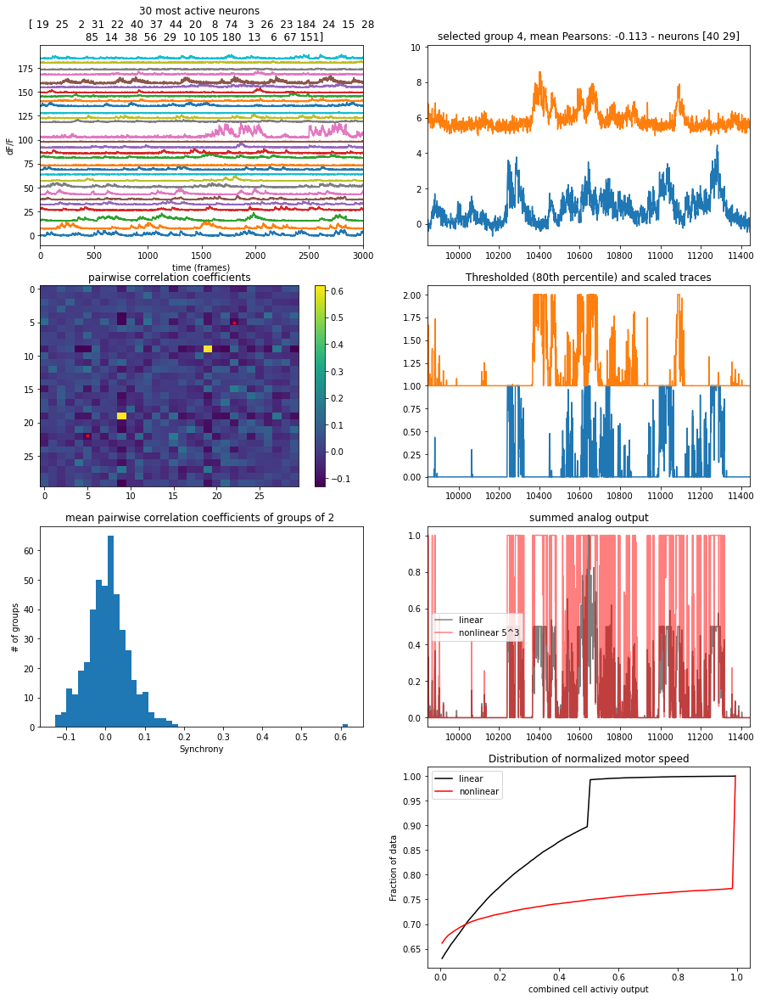

...

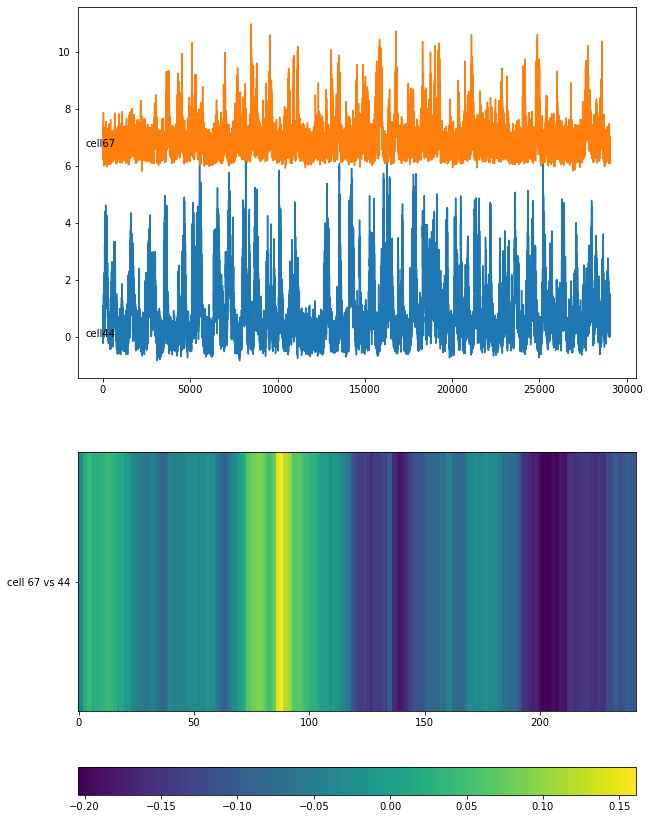

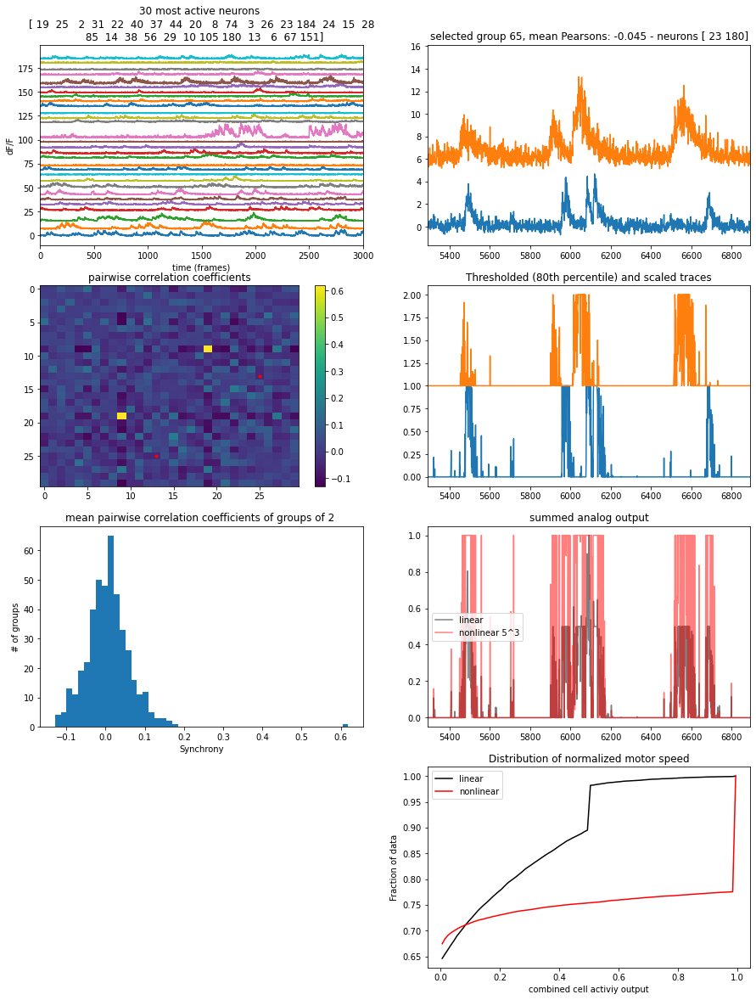

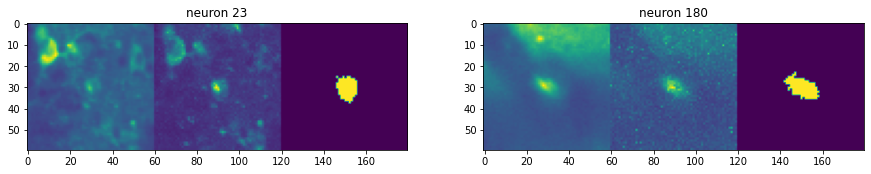

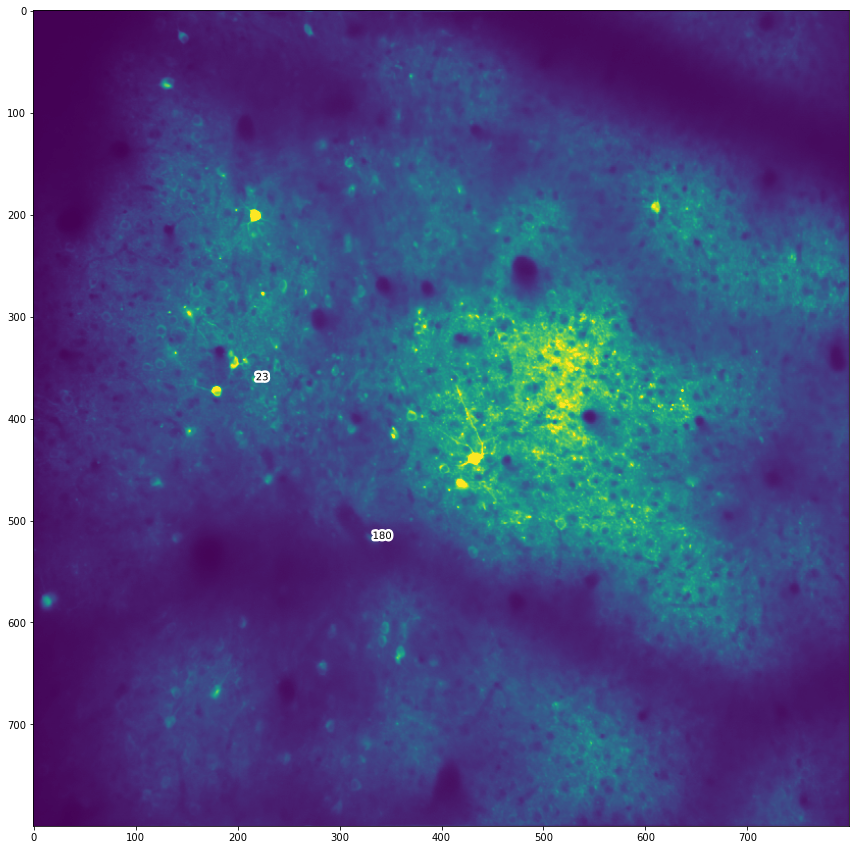

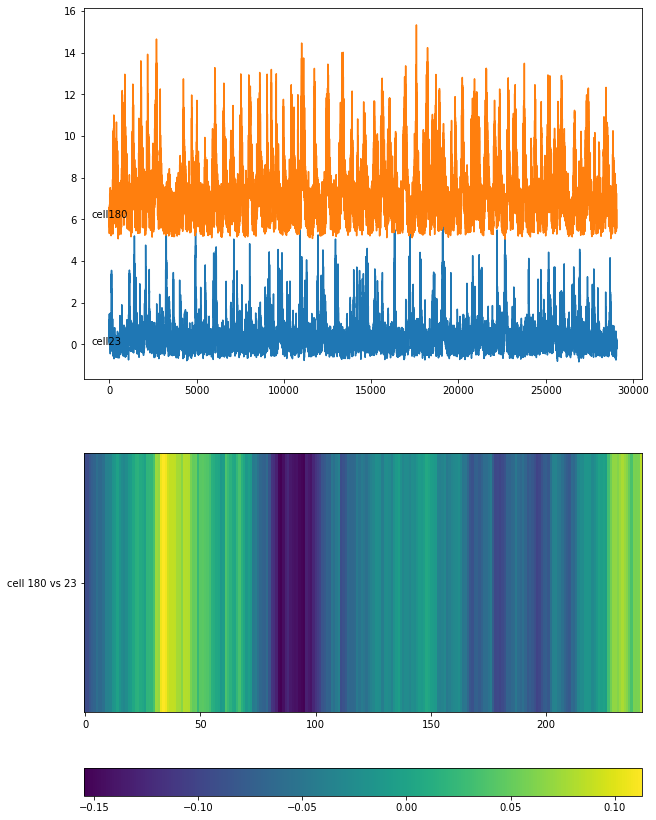

In [160]:
# suggest cell groups

import scipy
import itertools
import matplotlib.patheffects as PathEffects
save_pdf_copy_files = True


cells_to_consider = 30 #number of top activity cells
cells_to_select = 2 #number of cells in the conditioning group
groups_to_select = 10 #number of groups to select with different correlations
max_cell_repeat = 1 # in how many groups can a single cell participate
min_percentile = 80
exponent = 3
base_value = 5
binarize_activity = False # stupid idea??

minimum_pixel_num = 80

potential_cn_list = []

roi_pixel_range = 30 # display purposes
event_rate_copy = data_dict[session]['event_rate'].copy()
event_rate_copy[np.asarray(pixel_num_list)<minimum_pixel_num] = 0
cns = np.argsort(event_rate_copy)[::-1][:cells_to_consider]

DFFs = data_dict[session]['dff_sessionwise'][cns,:]

use_synchrony = False

pick_multiple_low_correlating_groups = True

corr_matrix = np.zeros([len(cns),len(cns)])
synchrony_matrix = np.zeros([len(cns),len(cns)])

if save_pdf_copy_files:
    Path(next_session_dir).mkdir(parents = True, exist_ok = True)
    pdf_obj = PdfPages(os.path.join(next_session_dir,'neuron_group_suggestions.pdf'))


for cni, cn in enumerate(cns):
    dff = data_dict[session]['dff_sessionwise'][cn,:]
    for cnii, cn2 in enumerate(cns):
        dff2 = data_dict[session]['dff_sessionwise'][cn2,:]
        if cn != cn2:
            #
            dff_rescaled = dff.copy()
            dff_rescaled = dff_rescaled-np.percentile(dff_rescaled,min_percentile)
            dff_rescaled = dff_rescaled/np.percentile(dff_rescaled,95)#*100
            dff_rescaled[dff_rescaled<0] = 0 
            dff_rescaled[dff_rescaled>1] = 1
            dff_rescaled2 = dff2.copy()
            dff_rescaled2 = dff_rescaled2-np.percentile(dff_rescaled2,min_percentile)
            dff_rescaled2 = dff_rescaled2/np.percentile(dff_rescaled2,95)#*100
            dff_rescaled2[dff_rescaled2<0] = 0 
            dff_rescaled2[dff_rescaled2>1] = 1 
            
            if binarize_activity:
                dff_rescaled[dff_rescaled>0] = 1
                dff_rescaled2[dff_rescaled2>0] = 1
            
            #rrsons_R, pearsons_p = scipy.stats.pearsonr(dff, dff2)
            pearsons_R, pearsons_p = scipy.stats.pearsonr(dff_rescaled, dff_rescaled2)
            
            synchrony = np.mean(((dff_rescaled+dff_rescaled2)/2)**exponent)
            # if use_synchrony:
            #     corr_matrix[cni,cnii] = synchrony#pearsons_R
            # else:
            corr_matrix[cni,cnii] = pearsons_R
            synchrony_matrix[cni,cnii] = synchrony

all_combos = itertools.combinations(np.arange(cells_to_consider),cells_to_select)

combos = []
sum_ccs = []
sum_synchs = []
for neurons_test in all_combos:
    ccs = []
    synchs = []
    for ni,n1 in enumerate(neurons_test):
        for n2 in neurons_test[:ni]:
            ccs.append(corr_matrix[n1,n2])
            synchs.append(synchrony_matrix[n1,n2])
    sum_cc = np.mean(ccs)
    sum_synchrony = np.mean(synchs)
    combos.append(neurons_test)
    sum_ccs.append(sum_cc)
    sum_synchs.append(sum_synchrony)

if use_synchrony:
    
    
    order_to_use = np.mean([scipy.stats.zscore(sum_ccs),scipy.stats.zscore(sum_synchs)],0)
else:
    order_to_use = sum_ccs
order_to_use   
voltage_outputs = []
cells_included_so_far = []
offset_cell_group = 0
for group_i in range(groups_to_select):
    if pick_multiple_low_correlating_groups:
        throw_out_group = True
        while throw_out_group:
            group_idx = group_i+offset_cell_group#int(group_i*(len(sum_ccs)-1)/np.max([(groups_to_select-1),1]))
            best_idx = np.argsort(order_to_use)[group_idx]
            throw_out_group = False
            for cell_now in  combos[best_idx]:
                if len(cells_included_so_far)>0:
                    if max_cell_repeat<= np.sum(np.concatenate(cells_included_so_far)==cell_now):
                        offset_cell_group+=1
                        throw_out_group = True
                        #print(offset_cell_group)
                        break
                
    else:
        group_idx = int(group_i*(len(sum_ccs)-1)/np.max([(groups_to_select-1),1]))
    best_idx = np.argsort(order_to_use)[group_idx]
    cells_included_so_far.append(combos[best_idx])
    
    
    fig = plt.figure(figsize = [15,20])
    ax1 = fig.add_subplot(4,2,1)
    ax2 = fig.add_subplot(4,2,3)
    ax3 = fig.add_subplot(4,2,5)
    ax4 = fig.add_subplot(4,2,2)
    ax5 = fig.add_subplot(4,2,6,sharex = ax4)
    ax6 = fig.add_subplot(4,2,4,sharex = ax4)
    ax7 = fig.add_subplot(4,2,8)
    offset =  0
    for cni, cn in enumerate(cns):
        dff = data_dict[session]['dff_sessionwise'][cn,:]
        ax1.plot(dff+offset)
        offset += np.max(dff)
    
    ax1.set_xlim([0,3000])
    ax1.set_title('{} most active neurons \n{}'.format(cells_to_consider,cns))
    ax1.set_ylabel('dF/F')
    ax1.set_xlabel('time (frames)')
    im = ax2.imshow(corr_matrix,aspect = 'auto',interpolation='none')
    if use_synchrony:
        ax2.set_title('pairwise synchrony coefficients')
    else:
        ax2.set_title('pairwise correlation coefficients')
        

    fig.colorbar(im, ax=ax2)

    
    
    for neuron_idx in combos[best_idx]:
        for neuron_idx2 in combos[best_idx]:
            if neuron_idx != neuron_idx2:
                ax2.plot(neuron_idx,neuron_idx2,'r.')
    ax3.hist(sum_ccs,50)
    if use_synchrony:
        ax3.set_title('mean pairwise synchrony of groups of {} '.format(cells_to_select))
    else:
        ax3.set_title('mean pairwise correlation coefficients of groups of {} '.format(cells_to_select))
    ax3.set_ylabel('# of groups')
    if use_synchrony:
        ax3.set_xlabel('Pearson''s R')
    else:
        ax3.set_xlabel('Synchrony')
    offset = 0
    traces = []
    offset_rescaled = 0
    rescaled_traces = []
    for neuron_idx in combos[best_idx]:
        dff = data_dict[session]['dff_sessionwise'][cns[neuron_idx],:]
        dff_rescaled = dff.copy()
        dff_rescaled = dff_rescaled-np.percentile(dff_rescaled,min_percentile)
        dff_rescaled = dff_rescaled/np.percentile(dff_rescaled,95)#*100
        dff_rescaled[dff_rescaled<0] = 0 
        dff_rescaled[dff_rescaled>1] = 1 
        rescaled_traces.append(dff_rescaled)
        if binarize_activity:
            dff_rescaled[dff_rescaled>0] = 1
        
        ax4.plot(dff+offset)
        ax6.plot(dff_rescaled+offset_rescaled)
        traces.append(dff_rescaled)
        offset += np.max(dff)
        offset_rescaled += np.max(dff_rescaled)
        
        potential_cn_list.append(cns[neuron_idx])
        #print(cn)
    voltage_outputs.append(np.prod(rescaled_traces,0))
    ax6.set_title('Thresholded ({}th percentile) and scaled traces'.format(min_percentile))
    if use_synchrony:
        ax4.set_title('selected group {}, mean synchrony {:.3e} - neurons {}'.format(group_idx,np.asarray(sum_ccs)[best_idx],cns[np.asarray(combos[best_idx])]))
    else:
        ax4.set_title('selected group {}, mean Pearson''s: {} - neurons {}'.format(group_idx,np.round(np.asarray(sum_ccs)[best_idx],3),cns[np.asarray(combos[best_idx])]))

    #ax5.plot(np.prod(np.asarray(traces),0))
    #ax5.set_ylim([0,.001])
    linear_sum = np.mean(np.asarray(traces),0)
    nonlinear_sum = ((np.mean(np.asarray(traces),0)*base_value)**exponent)
    nonlinear_sum[nonlinear_sum>1] = 1
    xpos = np.argmax(linear_sum)
    linear_sum = linear_sum/np.max(linear_sum)
    linear_sum[linear_sum>1]  = 1

    # nonlinear_sum = nonlinear_sum/np.percentile(nonlinear_sum,99)
    # nonlinear_sum[nonlinear_sum>1]  = 1
    ax5.plot(linear_sum,'k-',label = 'linear',alpha = .5)
    ax5.plot(nonlinear_sum,'r-',label = 'nonlinear {}^{}'.format(base_value,exponent),alpha = .5)
    ax4.set_xlim(np.asarray([-800,800])+xpos)
    ax5.legend()
    ax5.set_title('summed analog output')
    y,x = np.histogram(linear_sum,100)
    x = np.nanmean([x[:-1],x[1:]],0)
    ax7.plot(x,np.cumsum(y)/sum(y),'k-',label = 'linear')
    y,x = np.histogram(nonlinear_sum,100)
    x = np.nanmean([x[:-1],x[1:]],0)
    ax7.plot(x,np.cumsum(y)/sum(y),'r-',label = 'nonlinear')
    ax7.legend()
    ax7.set_ylabel('Fraction of data')
    ax7.set_xlabel('combined cell activiy output')
    ax7.set_title('Distribution of normalized motor speed')
    #ax5.set_ylim([0,1])

    
        
    fig_neuron_shapes = plt.figure(figsize = [15,10])
    fig_mean_image = plt.figure(figsize = [15,15])
    ax_mean_image_ = fig_mean_image.add_subplot(1,1,1)
    im_mean = ax_mean_image_.imshow(data_dict[session]['mean_image'])
    im_mean.set_clim(np.percentile(data_dict[session]['mean_image'].flatten(),[0,99.9]))
    for neuron_i,neuron_idx in enumerate(combos[best_idx]):
        idx = cns[neuron_idx]
        ax_mean_image = fig_neuron_shapes.add_subplot(3,2,neuron_i+1)
        y= int(data_dict[session]['roiY'][idx])
        x= int(data_dict[session]['roiX'][idx])
        s = data_dict[session]['mean_image'].shape
        mean_image_cutout = data_dict[session]['mean_image'][np.max([0,y-roi_pixel_range]):np.min([s[0],roi_pixel_range+y]),
                                                      np.max([0,x- roi_pixel_range]):np.min([s[1],roi_pixel_range+x])]
        mean_image_cutout = mean_image_cutout/np.max(mean_image_cutout)
        
        max_image_cutout = data_dict[session]['max_image'][np.max([0,y-roi_pixel_range]):np.min([s[0],roi_pixel_range+y]),
                                                      np.max([0,x- roi_pixel_range]):np.min([s[1],roi_pixel_range+x])]
        max_image_cutout = max_image_cutout/np.max(max_image_cutout)
        
        ROI_image = np.zeros_like(data_dict[session]['mean_image'])
        roi_stat = stat[idx]
        ROI_image[roi_stat['ypix'],roi_stat['xpix']] = 1    
        
        roi_image_cutout = ROI_image[np.max([0,y-roi_pixel_range]):np.min([s[0],roi_pixel_range+y]),
                                     np.max([0,x- roi_pixel_range]):np.min([s[1],roi_pixel_range+x])]
        
        ax_mean_image.imshow(np.concatenate([mean_image_cutout,max_image_cutout,roi_image_cutout],1))
        ax_mean_image.set_title('neuron {}'.format(idx))
        
        ax_mean_image_.plot(data_dict[session]['roiX'][idx],data_dict[session]['roiY'][idx],'r-')
        txt = ax_mean_image_.text(data_dict[session]['roiX'][idx],data_dict[session]['roiY'][idx], str(idx),color = 'black')
        txt.set_path_effects([PathEffects.withStroke(linewidth=5, foreground='w')])
        
 
        
        
    session_i = 0

    fig_corr = plt.figure(figsize = [10,15])
    ax1 = fig_corr.add_subplot(2,1,1)
    offset =  0
    corr_matrix_trace = []
    corr_matrix_labels = []
    window_size =5000
    window_step = 100
    for cni,cn in enumerate(cns[np.asarray(combos[best_idx])]):
        dff = data_dict[session]['dff_sessionwise'][cn,:]
        ax1.plot(dff+offset)
        ax1.text(-1000,offset,'cell{}'.format(cn))
        offset += np.max(dff)
    
        for cnii,cn2 in enumerate(cns[np.asarray(combos[best_idx])][:cni]):
            dff2 = data_dict[session]['dff_sessionwise'][cn2,:]
            corr_list = []
            for wstart in np.arange(0,len(dff)-window_size+window_step,window_step):
                wend = wstart + window_size
                pearsons_R, pearsons_p = scipy.stats.pearsonr(dff[wstart:wend], dff2[wstart:wend])
                corr_list.append(pearsons_R)
            corr_matrix_trace.append(np.asarray(corr_list))
            corr_matrix_labels.append('cell {} vs {}'.format(cn,cn2))



    corr_matrix_trace = np.asarray(corr_matrix_trace)
    #corr_matrix_norm = corr_matrix_trace-np.nanmean(corr_matrix_trace[:,:3],1)[:,np.newaxis]


    ax2 = fig_corr.add_subplot(2,1,2)
    im = ax2.imshow(corr_matrix_trace,aspect = 'auto',interpolation='none')
    fig_corr.colorbar(im, ax=ax2,location = 'bottom')
    ax2.set_yticks(np.arange(len(corr_matrix_labels)))
    ax2.set_yticklabels(corr_matrix_labels)
    #plt.plot(DFFs.T,alpha = .5)

    #ax1.set_xlim([0,5000])
    if save_pdf_copy_files:
        
        pdf_obj.savefig(fig)
        pdf_obj.savefig(fig_mean_image)
        pdf_obj.savefig(fig_neuron_shapes)
        pdf_obj.savefig(fig_corr)
    
    
    #asdasd
if save_pdf_copy_files:   
    file_list_to_copy_over = ['Z-positions.pdf',
                              'session_meanimages.tiff',
                              'ROI_sizes.pdf',
                              'ROIs.pdf',
                              'stat.mat',
                              'XYZ_motion.pdf',
                              'session_refImages.tiff',
                              'ops.mat']
    
    pdf_obj.close()
    
    #% save selected roi indices
    
    mdict = mdict={'potential_cn_list': potential_cn_list,
                   'meanImg': data_dict[session]['mean_image']}
    savemat(file_name=os.path.join(s2p_base_dir,subject, fov,'ops.mat'),
            mdict = mdict)
    # copy files over
    for file in file_list_to_copy_over:
        shutil.copyfile(os.path.join(s2p_base_dir,subject,fov,file),os.path.join(next_session_dir,file))

In [24]:
group_i

1

plot

In [23]:
group_idx

14.144867420196533

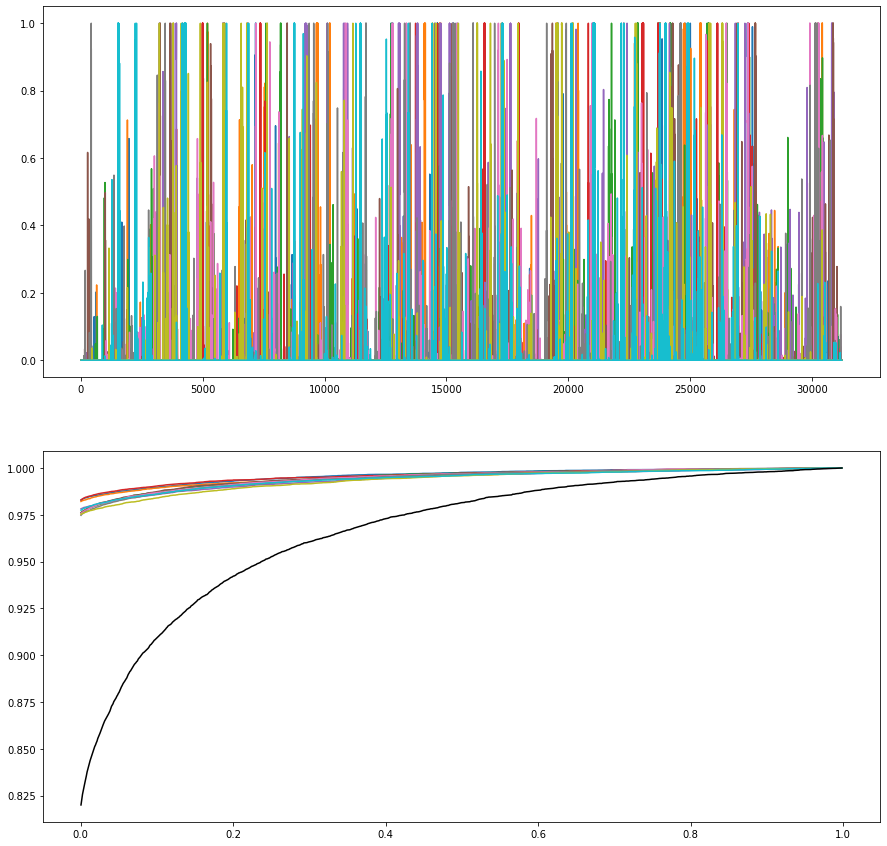

In [49]:
fig = plt.figure(figsize = [15,15])
ax_traces = fig.add_subplot(2,1,1)
ax_hists = fig.add_subplot(2,1,2)
x = np.arange(0,1,.001)
for v in voltage_outputs:
    v = v.copy()*2
    v[v>1] = 1
    ax_traces.plot(v)
    y,x_ = np.histogram(v,x)
    x_ = np.nanmean([x[:-1],x[1:]],0)
    ax_hists.plot(x_,np.cumsum(y)/np.sum(y))
#plt.plot(,'black',linewidth = 1)
y,x_ = np.histogram(np.max(np.asarray(voltage_outputs),0),x)
x_ = np.nanmean([x[:-1],x[1:]],0)
ax_hists.plot(x_,np.cumsum(y)/np.sum(y),'black')

/tmp/ipykernel_31466/2604829062.py:137: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize = [16,8])


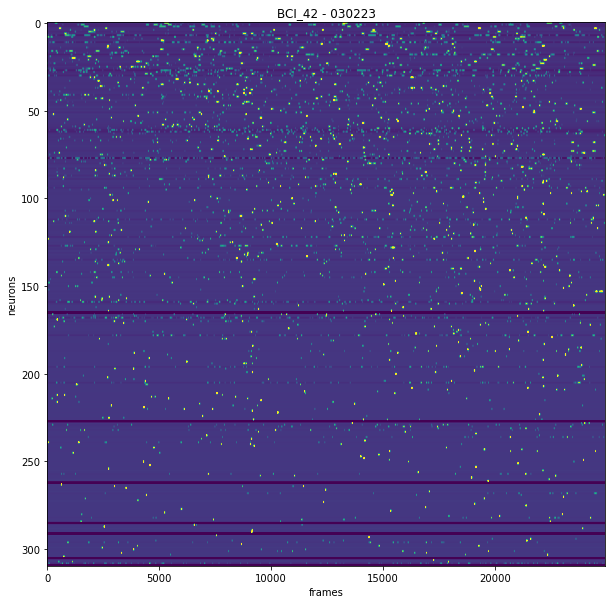

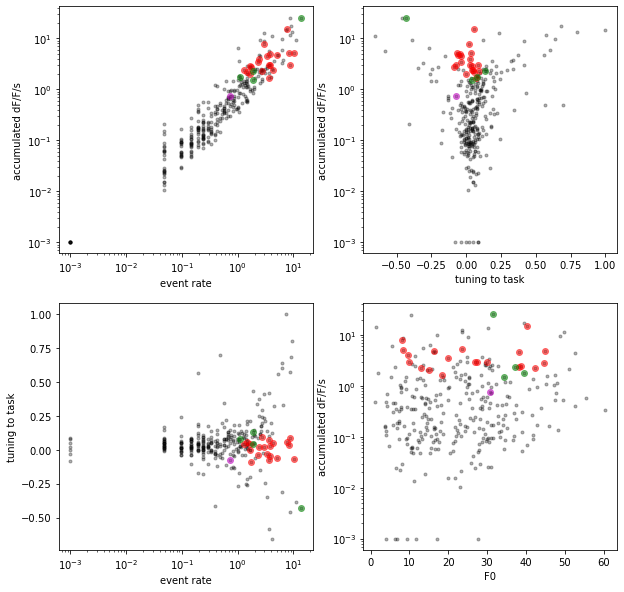

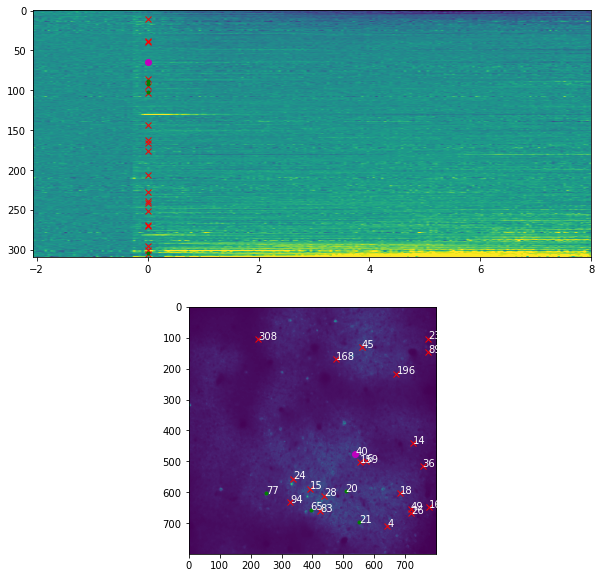

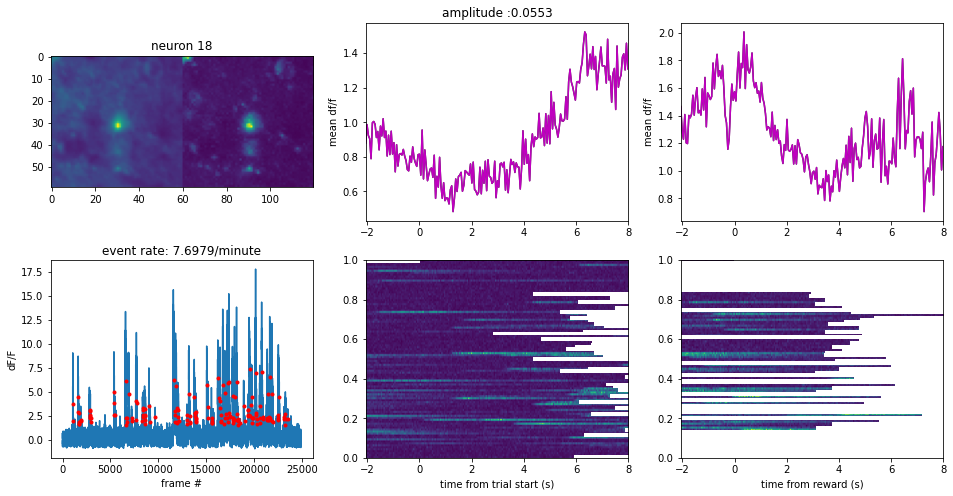

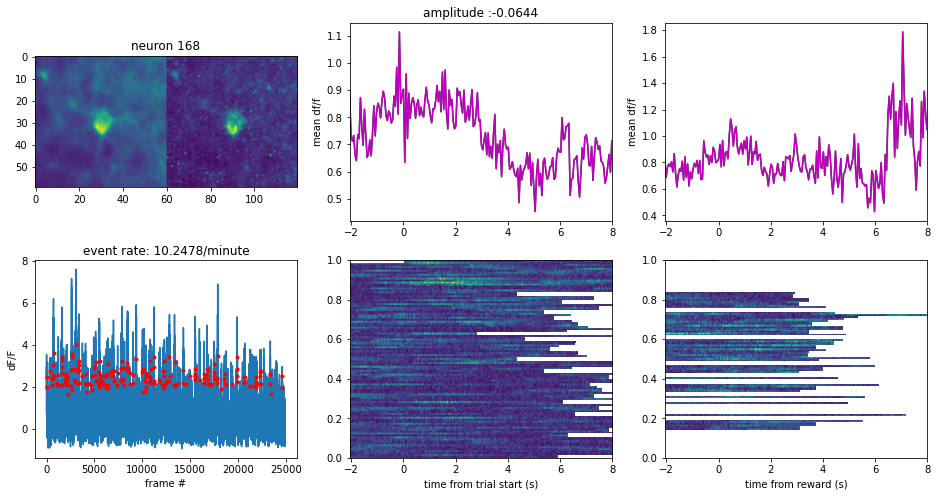

...

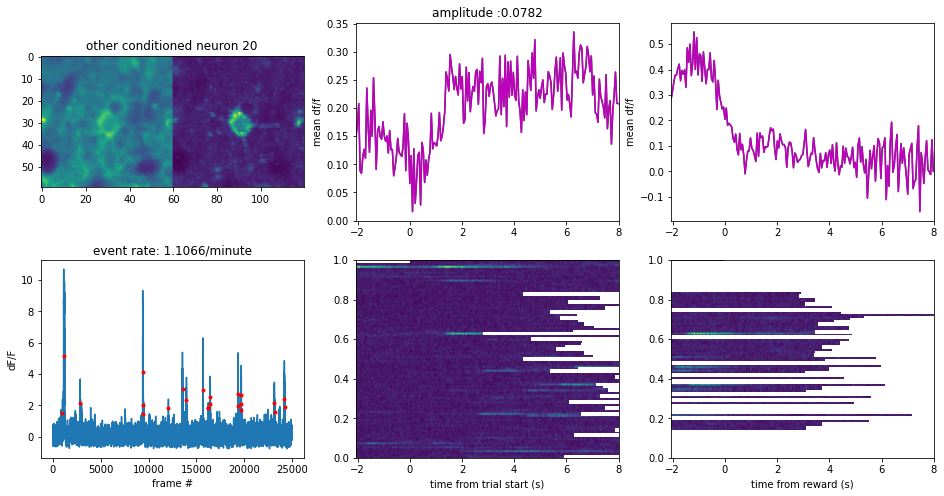

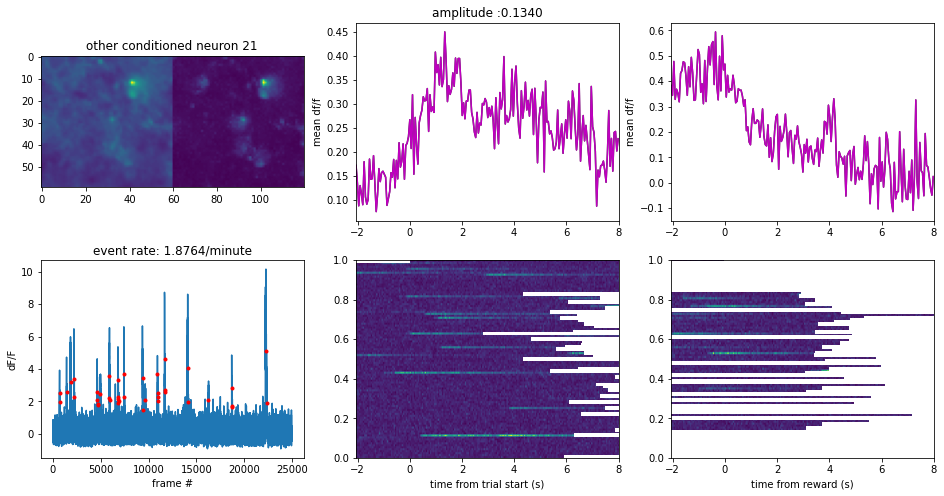

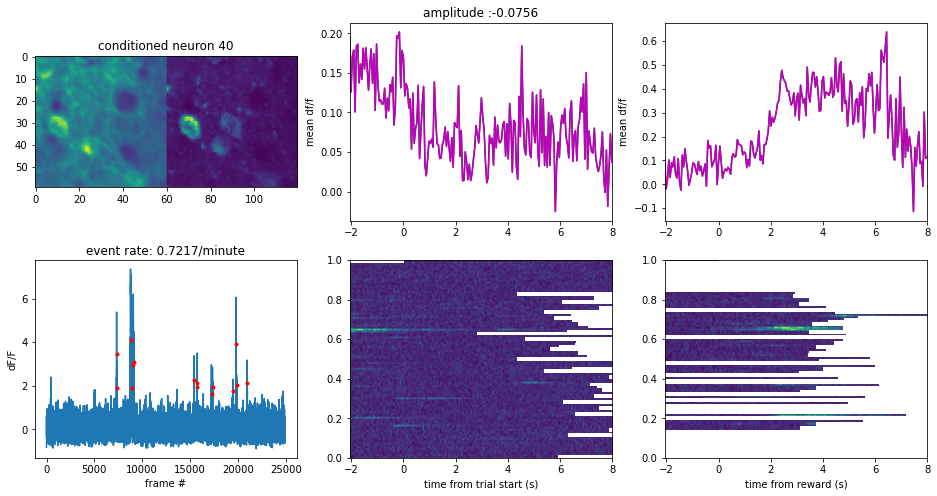

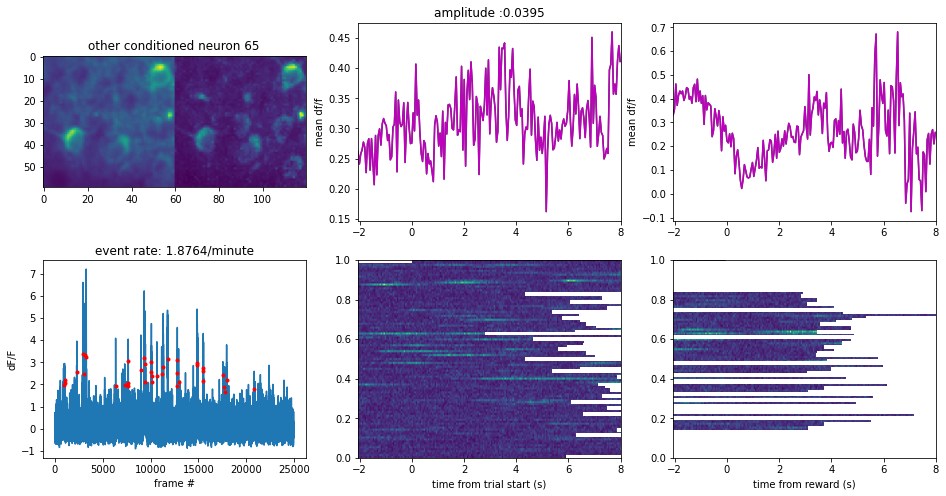

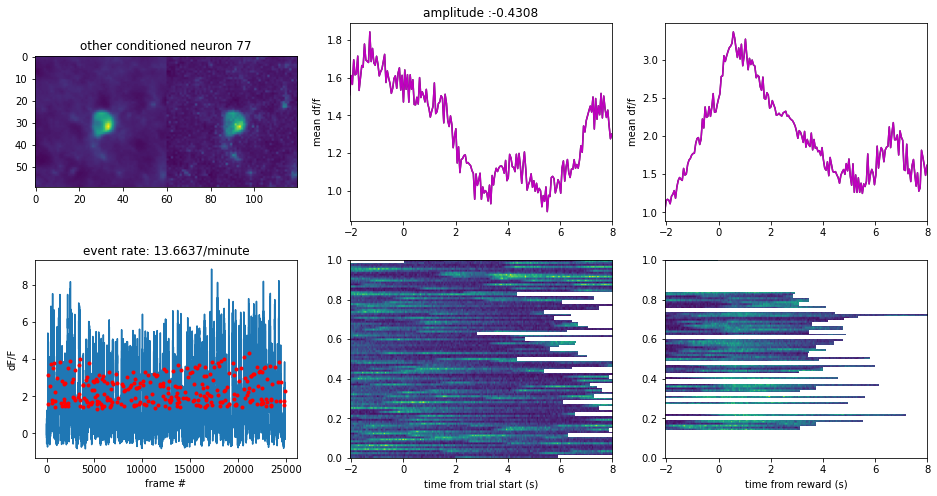

In [27]:
# plotting
#cn_list = np.concatenate(cn_list)
save_pdf_copy_files = True
needed_neuron_num = 20
target_amplitude = np.nan
max_abs_amplitude = .1
minimum_pixel_num = 60
min_event_rate = .5
target_amplitude_rate_percentile = 100#95
minimum_f0_percentile = 25
target_event_rate = 20

roi_pixel_range = 30 # display purposes
last_session = sessions[-1]
if len(sessions)>1:
    previous_session = sessions[-2]
else:
    previous_session = sessions[-1]
cn = np.median(np.asarray(data_dict[last_session]['cn'])[np.asarray(data_dict[last_session]['cn'])!=None])

if save_pdf_copy_files:
    Path(next_session_dir).mkdir(parents = True, exist_ok = True)
    pdf_obj = PdfPages(os.path.join(next_session_dir,'conditioned_neuron_suggestions.pdf'))
    
    
%matplotlib inline
    
fig = plt.figure(figsize = [10,10])
ax = fig.add_subplot(111)
events_zscore = zscore(data_dict[last_session]['events_clean'],1)
events_zscore[np.isnan(events_zscore)] = -3
im_events = ax.imshow(events_zscore,aspect = 'auto')  
ax.set_ylabel('neurons')    
ax.set_xlabel('frames')    
#im_events.set_clim(np.percentile(data_dict[last_session]['dff_sessionwise'].flatten(),[5,90])) 
im_events.set_clim([-1,5])
ax.set_title('{} - {}'.format(subject,last_session))
if save_pdf_copy_files:
    pdf_obj.savefig(fig) 
    #break
#%
from scipy.stats import zscore
fig = plt.figure(figsize = [10,10])
ax_1 = fig.add_subplot(2,2,1)
ax_1.plot(data_dict[last_session]['event_rate'],data_dict[last_session]['amplitude_rate'],'k.',alpha = .3)
ax_1.set_yscale('log')
ax_1.set_xlabel('event rate')
ax_1.set_xscale('log')  
ax_1.set_ylabel('accumulated dF/F/s')
#%
ax_2 = fig.add_subplot(2,2,2,sharey = ax_1)
ax_2.plot( data_dict[last_session]['trial_averaged_amplitude'],data_dict[last_session]['amplitude_rate'],'k.',alpha = .3)
ax_2.set_yscale('log')
ax_2.set_ylabel('accumulated dF/F/s')
ax_2.set_xlabel('tuning to task')

ax_3 = fig.add_subplot(2,2,3,sharex = ax_1)
ax_3.plot(data_dict[last_session]['event_rate'], data_dict[last_session]['trial_averaged_amplitude'],'k.',alpha = .3)
ax_3.set_xlabel('event rate')
ax_3.set_xscale('log') 
ax_3.set_ylabel('tuning to task')

ax_4 = fig.add_subplot(2,2,4)
ax_4.plot(data_dict[last_session]['f0_scalar'],data_dict[last_session]['amplitude_rate'],'k.',alpha = .3)
ax_4.set_xlabel('F0')
ax_4.set_yscale('log') 
ax_4.set_ylabel('accumulated dF/F/s')




target_amplitude_rate = np.percentile(data_dict[last_session]['amplitude_rate'],target_amplitude_rate_percentile)
amplitude_rate_log = np.log(data_dict[last_session]['amplitude_rate'])
event_rate_log = np.log(data_dict[last_session]['event_rate'])
event_rate_log

f0 = data_dict[last_session]['f0_scalar']
minimum_f0 = np.percentile(f0,minimum_f0_percentile)

amplitudes_zscore = (np.asarray( data_dict[last_session]['trial_averaged_amplitude'])-np.nanmedian( data_dict[last_session]['trial_averaged_amplitude']))/np.nanstd( data_dict[last_session]['trial_averaged_amplitude'])
amplitude_rate_zscore = (amplitude_rate_log-np.nanmedian(amplitude_rate_log))/np.nanstd(amplitude_rate_log)
event_rate_zscore = (event_rate_log-np.nanmedian(event_rate_log))/np.nanstd(event_rate_log)
f0_zscore = (f0-np.median(f0))/np.std(f0)
if np.isnan(target_amplitude):
    distances = np.sqrt((np.asarray(amplitude_rate_zscore)-(np.log(target_amplitude_rate)-np.nanmedian(amplitude_rate_log))/np.nanstd(amplitude_rate_log))**2 + 
                        (np.asarray(event_rate_zscore)-(np.log(target_event_rate)-np.nanmedian(event_rate_log))/np.nanstd(event_rate_log))**2)
                        #(np.asarray(f0_zscore)-(target_f0-np.nanmedian(f0))/np.nanstd(f0))**2)# + (amplitudes-target_amplitude)**2)
else:
    distances = np.sqrt((np.asarray(amplitudes_zscore)-(target_amplitude-np.nanmedian(amplitude))/np.nanstd(amplitude))**2 +
                        (np.asarray(amplitude_rate_zscore)-(np.log(target_amplitude_rate)-np.nanmedian(amplitude_rate_log))/np.nanstd(amplitude_rate_log))**2 + 
                        (np.asarray(event_rate_zscore)-(np.log(target_event_rate)-np.nanmedian(event_rate_log))/np.nanstd(event_rate_log))**2)
                        #(np.asarray(f0_zscore)-(target_f0-np.nanmedian(f0))/np.nanstd(f0))**2)# + (amplitudes-target_amplitude)**2)
distances[np.abs( data_dict[last_session]['trial_averaged_amplitude'])>max_abs_amplitude] += np.inf
#distances[data_dict[last_session]['event_rate']<min_event_rate] += np.inf
#distances[data_dict[last_session]['f0_scalar']<minimum_f0] += np.inf
distances[pixel_num_list<minimum_pixel_num] += np.inf
potential_cn_list = np.argsort(distances)[:needed_neuron_num]
potential_cn_list = np.concatenate([potential_cn_list,cn_list])
potential_cn_list = np.asarray(potential_cn_list,int)
for idx in potential_cn_list:
    if idx == cn:
        color = 'mo'
    elif idx in cn_list:
        color = 'go'
    else:
        color = 'ro'
    ax_1.plot(data_dict[last_session]['event_rate'][idx],data_dict[last_session]['amplitude_rate'][idx],color,alpha = .5)
    ax_2.plot( data_dict[last_session]['trial_averaged_amplitude'][idx],data_dict[last_session]['amplitude_rate'][idx],color,alpha = .5)
    ax_3.plot(data_dict[last_session]['event_rate'][idx], data_dict[last_session]['trial_averaged_amplitude'][idx],color,alpha = .5)
    ax_4.plot(data_dict[last_session]['f0_scalar'][idx],data_dict[last_session]['amplitude_rate'][idx],color,alpha = .5)
if save_pdf_copy_files:
    pdf_obj.savefig(fig) 
#%

fig_meanimage = plt.figure(figsize = [10,10])
ax_mean_activity = fig_meanimage.add_subplot(2,1,1)
ax_mean_image_ = fig_meanimage.add_subplot(2,1,2)
ax_mean_image_.imshow(data_dict[last_session]['mean_image'])
detectable_event_ratio = np.mean(data_dict[last_session]['signal_to_noise_trace']>minimum_d_prime,1)
order = np.argsort( data_dict[last_session]['trial_averaged_amplitude'])
im_mean_activity = ax_mean_activity.imshow(mean_activity_matrix_normalized[order,:],aspect= 'auto',extent = [data_dict[last_session]['time_since_trial_start'][0],data_dict[last_session]['time_since_trial_start'][-1],mean_activity_matrix_normalized.shape[0]-.5,-.5])
ax_mean_activity.set_xlim([data_dict[last_session]['time_since_trial_start'][0],time_to_average_after_trial_start])
# =============================================================================
# ticks = np.arange(0,len(data_dict[last_session]['time_since_trial_start']),np.argmax(data_dict[last_session]['time_since_trial_start']>0)-1)#np.asarray(ax_mean_activity.get_xticks(),int)[1:-1]
# ax_mean_activity.set_xticks(ticks)
# ax_mean_activity.set_xticklabels(np.round(data_dict[last_session]['time_since_trial_start'][ticks],2))
# =============================================================================

im_mean_activity.set_clim(np.percentile(mean_activity_matrix_normalized.flatten(),[5,95]))
#%





for idx in potential_cn_list:#cn_list:#potential_cn_list:
    fig = plt.figure(figsize = [16,8])
    ax_mean_image = fig.add_subplot(2,3,1)
    ax_trial_average = fig.add_subplot(2,3,2)
    ax_whole_session = fig.add_subplot(2,3,4)
    ax_trial_locked_activity = fig.add_subplot(2,3,5,sharex = ax_trial_average)
    
    ax_reward_average = fig.add_subplot(2,3,3,sharex = ax_trial_average)
    ax_reward_locked_activity = fig.add_subplot(2,3,6,sharex = ax_trial_average)
    
    y= int(data_dict[last_session]['roiY'][idx])
    x= int(data_dict[last_session]['roiX'][idx])
    
    s = data_dict[last_session]['mean_image'].shape
    mean_image_cutout = data_dict[last_session]['mean_image'][np.max([0,y-roi_pixel_range]):np.min([s[0],roi_pixel_range+y]),
                                                              np.max([0,x- roi_pixel_range]):np.min([s[1],roi_pixel_range+x])]
    mean_image_cutout = mean_image_cutout/np.max(mean_image_cutout)
    max_image_cutout = data_dict[last_session]['max_image'][np.max([0,y-roi_pixel_range]):np.min([s[0],roi_pixel_range+y]),
                                                              np.max([0,x- roi_pixel_range]):np.min([s[1],roi_pixel_range+x])]
    max_image_cutout = max_image_cutout/np.max(max_image_cutout)
    ax_mean_image.imshow(np.concatenate([mean_image_cutout,max_image_cutout],1))
    if idx == cn:
        color = 'mo'
        ax_mean_image.set_title('conditioned neuron {}'.format(idx))
    elif idx in cn_list:
        color = 'g.'
        ax_mean_image.set_title('other conditioned neuron {}'.format(idx))
    else:
        color = 'rx'
        ax_mean_image.set_title('neuron {}'.format(idx))
    ax_mean_image_.plot(data_dict[last_session]['roiX'][idx],data_dict[last_session]['roiY'][idx],color)
    ax_mean_image_.text(data_dict[last_session]['roiX'][idx],data_dict[last_session]['roiY'][idx], str(idx),color = 'white')
    ax_mean_activity.plot(0,order[idx],color)
    needed_frames_prev= data_dict[previous_session]['time_since_trial_start']<time_to_average_after_trial_start
    ax_trial_average.plot(data_dict[previous_session]['time_since_trial_start'][needed_frames_prev],data_dict[previous_session]['mean_activity_matrix'][idx,needed_frames_prev],'k-',alpha =.8)
    needed_frames= data_dict[last_session]['time_since_trial_start']<time_to_average_after_trial_start
    ax_trial_average.plot(data_dict[last_session]['time_since_trial_start'][needed_frames],mean_activity_matrix[idx,needed_frames],'m-')
    
    ax_trial_locked_activity.set_xlabel('time from trial start (s)')
    ax_trial_average.set_ylabel('mean df/f')
    ax_trial_average.set_title('amplitude :{0:.4f}'.format( data_dict[last_session]['trial_averaged_amplitude'][idx]))
    ax_trial_average.set_xlim([data_dict[last_session]['time_since_trial_start'][0],time_to_average_after_trial_start])
    ax_trial_locked_activity.imshow(trialwise_dff_until_reward[:,idx,:].squeeze().T,aspect = 'auto',extent = [data_dict[last_session]['time_since_trial_start'][0],data_dict[last_session]['time_since_trial_start'][-1],0,1])
    
    ax_reward_average.plot(data_dict[previous_session]['time_since_trial_start'][needed_frames_prev],data_dict[previous_session]['mean_reward_matrix'][idx,needed_frames_prev],'k-',alpha =.8)
    ax_reward_average.plot(data_dict[last_session]['time_since_trial_start'][needed_frames],mean_reward_matrix[idx,needed_frames],'m-')
    ax_reward_locked_activity.set_xlabel('time from reward (s)')
    ax_reward_average.set_ylabel('mean df/f')
    ax_reward_locked_activity.imshow(trialwise_reward_matrix[:,idx,:].squeeze().T,aspect = 'auto',extent = [data_dict[last_session]['time_since_trial_start'][0],data_dict[last_session]['time_since_trial_start'][-1],0,1])
    ax_trial_average.set_xlim([data_dict[last_session]['time_since_trial_start'][0],time_to_average_after_trial_start])
    
# =============================================================================
#     xticks = ax_trial_locked_activity.get_xticks()
#     xticks = np.asarray(xticks[(xticks>0)&(xticks<len(data_dict[last_session]['time_since_trial_start']))],int)
#     ax_trial_locked_activity.set_xticks(xticks)
#     ax_trial_locked_activity.set_xticklabels(np.round(data_dict[last_session]['time_since_trial_start'][xticks],2))
# =============================================================================
    
    ax_whole_session.plot(data_dict[last_session]['dff_sessionwise'][idx,:])
    #%
    for start_,end_ in  zip(np.where(np.diff(np.concatenate([[0],data_dict[last_session]['events_clean'][idx,:],[0]]))>0)[0],
                            np.where(np.diff(np.concatenate([[0],data_dict[last_session]['events_clean'][idx,:],[0]]))<0)[0]):
        center_idx = int(np.mean([start_,end_]))
        ax_whole_session.plot(center_idx,data_dict[last_session]['events_clean'][idx,center_idx],'r.')
                            
# =============================================================================
#     ax_whole_session.plot(np.where(data_dict[last_session]['events_clean'][idx,:]>0)[0],data_dict[last_session]['dff_sessionwise'][idx,data_dict[last_session]['events_clean'][idx,:]>0],'r.')
# =============================================================================
    ax_whole_session.set_xlabel('frame #')
    ax_whole_session.set_ylabel('dF/F')
    ax_whole_session.set_title('event rate: {0:.4f}/minute'.format(data_dict[last_session]['event_rate'][idx]))
    if save_pdf_copy_files:
        pdf_obj.savefig(fig) 
    #plt.close()
    #break
if save_pdf_copy_files:    
    pdf_obj.savefig(fig_meanimage) 
    pdf_obj.close()
    
    #% save selected roi indices
    mdict = mdict={'potential_cn_list': potential_cn_list.tolist(),
                   'meanImg': data_dict[last_session]['mean_image']}
    savemat(file_name=os.path.join(s2p_base_dir,subject, fov,'ops.mat'),
            mdict = mdict)
    # copy files over
    for file in file_list_to_copy_over:
        shutil.copyfile(os.path.join(s2p_base_dir,subject,fov,file),os.path.join(next_session_dir,file))